In [95]:
from collections import Counter

import pymongo as mo
import re
import pandas as pd
import pandas as pd
import jieba
import jieba.posseg as psg
from transformers import BertTokenizer, BertModel
import torch
import numpy as np
from sentence_transformers import SentenceTransformer
import umap
from sklearn.feature_extraction.text import TfidfVectorizer, CountVectorizer
from sklearn.decomposition import LatentDirichletAllocation
from sklearn.cluster import KMeans
from matplotlib import pyplot as plt
from wordcloud import WordCloud
import matplotlib.pyplot as plt


In [3]:
client = mo.MongoClient("mongodb://localhost:27017/")
db = client["eastmoneys_news"]
collection = db["shuzi_new"]


In [21]:
def clear_str(str_raw:str):
    for pat in ['\\n', ' ', ' ', '\r', '\\xa0', '\n\r\n','\n','查看详情>>\n\n\n','\t','$','\\\u3000','主力资金加仓名单实时更新，APP内免费看>>','（文章来源：([\u4e00-\u9fa5]+·[\u4e00-\u9fa5]+)）']:
        str_raw.replace(pat,'')
        str_raw = re.sub(fr'{pat}','',str_raw)
    # str_raw.replace('查看详情>>\\n\\n\\n','')
    return str_raw

def concatenate_columns(row, column1, column2):
    
        return row[column1] + row[column2]

In [27]:
datas = collection.find()
title_set = set()
finaldata_list = []
for data in datas:
    if data['title'] not in title_set:
        title_set.add(data['title'])
        try:
            if '惠博普' not in data['title']:
                data['body'] = clear_str(data['body'])
                finaldata_list.append(data)
        except:continue
        # print(data['title'])
    else:
        print(data['title'])
        

普惠金融：助企纾困的一把利剑
数字普惠金融为乡村振兴提“智”增效
上海经信委等部门：鼓励符合条件的金融机构参与碳普惠绿色投融资服务
央行等部门印发三地普惠金融改革试验区总体方案
央行等部门印发三地普惠金融改革试验区总体方案
央行等部门印发三地普惠金融改革试验区总体方案
央行等部门印发三地普惠金融改革试验区总体方案
光大银行副行长齐晔展望养老金融未来：普惠化、数字化、综合化
江西金融助力稳企纾困 带动新增普惠小微贷150亿元
人民银行尹优平：金融健康是普惠金融发展的高级形态
普惠金融助力中小企业发展
助力普惠金融 数字人民币无障碍设计课题报告发布
助力普惠金融 数字人民币无障碍设计课题报告发布
21金融研究院：数字普惠稳健发展必须先要筑牢金融科技伦理根基
潘功胜：持续健全数字普惠金融服务体系
潘功胜：持续健全数字普惠金融服务体系
普惠金融：助企纾困的一把利剑
普惠金融：助企纾困的一把利剑
数字人民币扩围提升金融普惠性
普惠金融如何助力共同富裕
中国互联网金融协会单强：从数字化、绿色化、生态化、负责任四方面入手 推进普惠金融高质量发展
小微金融服务“质效双升”数字普惠成重点目标
共同富裕与数字普惠金融发展研究
邮储银行郴州市分行     开展“金融夜校” 践行普惠金融
普百业 惠万千 中山工商银行数字普惠，助力稳经济促发展
普惠金融惠民润企 中信银行深圳分行：与特区同发展促繁荣
时报观察丨守护新市民金融健康 培育普惠金融“第二曲线”
国务院发展研究中心金融研究所原所长张承惠：新形势下中国普惠金融要向2.0版本转型
普惠金融顾问服务枢纽揭牌
三级物流入村 普惠金融到户
《中国普惠金融发展报告（2022）》发布
上海普惠金融顾问普陀服务枢纽成立
普惠金融立新功：金融“活水”精准滴灌小微企业
“普惠金融-景气指数”发布会在京举行
央行：2021年末全国普惠小微贷款余额、授信户数同比分别增长27.3%、38.0%
农行永州分行 全力推进“普惠金融工程”
惠博普：公司目前拥有柳林地区煤层气资源开采产品分成合同的权益
惠博普：公司对控股子公司提供的担保总额约合约2.65亿元人民币
惠博普董事黄松个人名下持股减少786万股 涉及金额2680.26万元
惠博普：中标马基努油田DS2含水原油处理集输站升级改造EPC项目
平安普惠总经理陈东起兼任陆金所董事长
发力普惠金融 助推乡村振兴 农

In [28]:
# 数据清洗函数
stop_file = 'E:\财经新闻爬虫\cn_stopwords.txt'
stopword_list = open(stop_file,encoding ='utf-8')
stop_list = []
other_stop = ['普惠','数字','金融']
for line in stopword_list:
    line = re.sub(u'\n|\\r', '', line)
    stop_list.append(line)
stop_list.extend(other_stop)

In [29]:
# 数据准备
data_frame = pd.DataFrame(finaldata_list)
data_frame = data_frame.dropna(how='any')
data_frame['total_content'] = data_frame.apply(lambda row: concatenate_columns(row, 'title', 'body'), axis=1)

In [110]:
# 总的词云生成函数
from PIL import Image
import numpy as np
def generate_wordcloud_gernel(words):
    word_counter = Counter(words)
    mask_path = 'E:\财经新闻爬虫\cloud.png'
    mask = np.array(Image.open(mask_path))
    plt.figure(figsize=(10, 6))
    font_path = 'E:\财经新闻爬虫\shangshouqingbaiti.ttf'
    wordcloud = WordCloud(font_path=font_path,background_color='white',mask=mask,max_words=100)
    wordcloud.generate_from_frequencies(word_counter)
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    plt.savefig('wordcloud.png', dpi=600)
    plt.show()

In [138]:
import jieba.posseg as pseg
test = '需要'
a = pseg.cut(test)
for c,d in a:
    print(c,d)

需要 v


In [97]:
def chinese_word_cut(sentence):
    word_list = []
    #jieba分词
    seg_list = jieba.lcut(sentence)
    for seg_word in seg_list:
        # word = re.sub(u'[^\u4e00-\u9fa5]','')
        if seg_word not in stopword_list and len(seg_word)>1:
            word_list.append(seg_word)
       
    return (" ").join(word_list)

# def chinese_word_cut2(sentence):
#     words = pseg.cut(sentence)
#     for seg_word,pos in words:
#         if pos in ['n','v','adj']
#             if seg_word not in stopword_list and len(seg_word)>1:
            


In [139]:
data_frame['content_cutted'] = data_frame['total_content'].apply(chinese_word_cut)
tf_vectorizer = CountVectorizer(strip_accents = 'unicode',
                                # max_features=n_features,
                                stop_words='english',
                                max_df = 0.5,
                                min_df = 10)
tf = tf_vectorizer.fit_transform(data_frame.content_cutted)

In [52]:
n_topics = 8
lda = LatentDirichletAllocation(n_components=n_topics, max_iter=50,
                                learning_method='batch',
                                learning_offset=50,
#                                 doc_topic_prior=0.1,
#                                 topic_word_prior=0.01,
                               random_state=0)
lda.fit(tf)
vec_lda = lda.transform(tf)

In [147]:
import os 
path_result = 'E:\财经新闻爬虫\lda_result2'

In [148]:
def print_top_words(model, feature_names, n_top_words):
    tword = []
    for topic_idx, topic in enumerate(model.components_):
        print("Topic #%d:" % topic_idx)
        topic_w = " ".join([feature_names[i] for i in topic.argsort()[:-n_top_words - 1:-1]])
        tword.append(topic_w)
        
        print(topic_w)
    return tword

In [151]:
def generate_wordcloud(words, importance,path,topic_number):
    wordcloud_data = {word: importance[idx] for idx, word in enumerate(words)}
    font_path = 'D:\\texlive\\2022\\texmf-dist\\fonts\\truetype\public\\arvo\Arvo-Bold.ttf'
    font_path = 'E:\财经新闻爬虫\shangshouqingbaiti.ttf'
    
    wordcloud = WordCloud(font_path=font_path,background_color='white',max_words=50)
    wordcloud.generate_from_frequencies(wordcloud_data)
    plt.figure(figsize=(10, 6))
    plt.imshow(wordcloud, interpolation='bilinear')
    plt.axis('off')
    final_path = os.path.join(path,f'topic{topic_number}.png')
    plt.savefig(final_path,dpi=300)
    plt.show()
    plt.close()

0


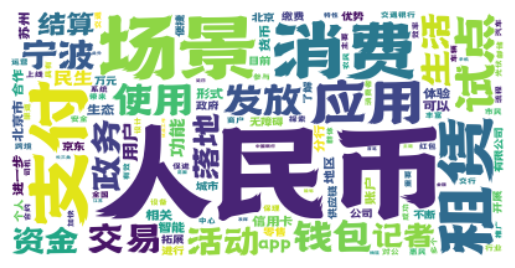

1


KeyboardInterrupt: 

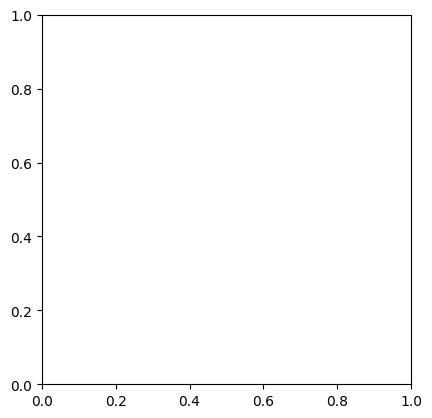

In [111]:
tf_feature_names = tf_vectorizer.get_feature_names_out()
for topic_idx, topic in enumerate(lda.components_):
    print(topic_idx)
    generate_wordcloud(list(tf_feature_names),list(topic))

In [115]:
def write_list_to_txt(lst, filename):
    directory = os.path.dirname(filename)
    if not os.path.exists(directory):
        os.makedirs(directory)
    with open(filename, 'w') as file:
        i = 0
        for item in lst:
            file.write(f'#topic{i}'+ '\n')
            file.write(str(item) + '\n')
            i+=1
    print(f"Data written to {filename} successfully.")

Topic #0:
风险 问题 乡村 健康 信息 转型 市场 我国 保险 需要 农村 重要 机构 可以 成本 监管 报告 中小 政策 信用 高质量 基础 行业 完善 进行
Topic #1:
亿元 乡村 增长 分行 信贷 振兴 余额 截至 深圳 该行 实体 累计 推出 打造 普惠小微 加大 同比 邮储 工作 高质量 资金 重点 线上 农村 年末
Topic #2:
消费 人民币 绿色 上海 场景 活动 应用 公司 产业 支付 有限公司 行业 实体 单位 案例 金融公司 合作 试点 市民 打造 顾问 生活 用户 中心 优势
Data written to E:\财经新闻爬虫\lda_result2\3\topic.txt successfully.


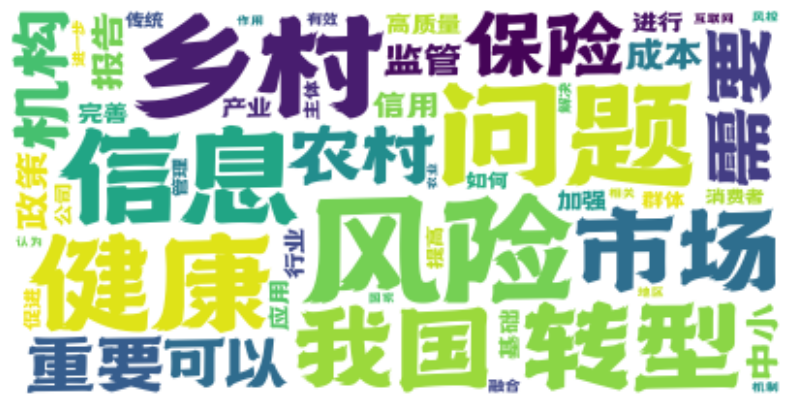

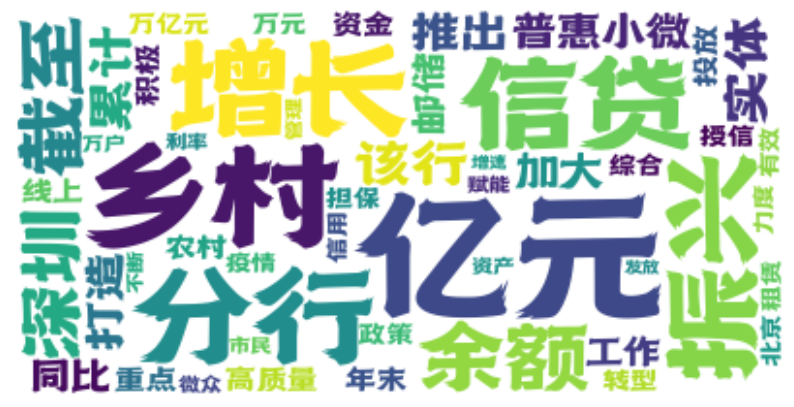

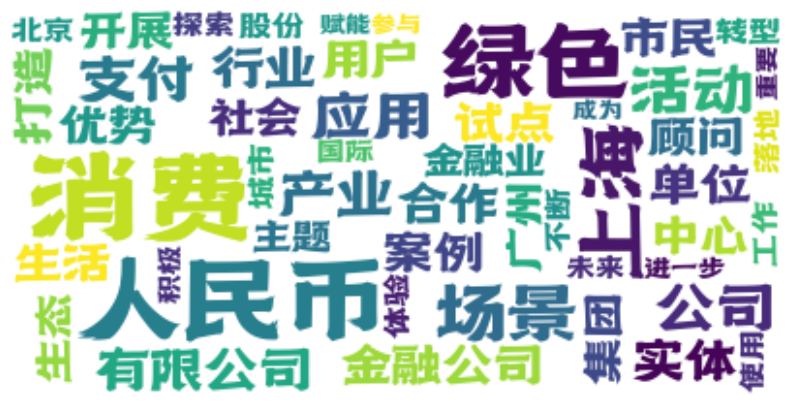

Topic #0:
人民币 乡村 场景 农村 信息 应用 信用 支付 问题 可以 振兴 地区 农业 信贷 传统 消费 资金 用户 成本 进行 记者 风险 提高 试点 有效
Topic #1:
分行 乡村 亿元 振兴 深圳 打造 推出 工作 实体 线上 累计 信贷 邮储 担保 市民 高质量 重点 资金 积极 产业 截至 合作 政策 中小 租赁
Topic #2:
消费 绿色 增长 亿元 余额 同比 年末 万亿元 普惠小微 增速 转型 截至 公司 金融公司 资产 平安 显示 单位 实体 规模 该行 管理 利率 北京 信贷
Topic #3:
健康 上海 风险 保险 转型 产业 行业 机构 高质量 实体 消费者 市场 公司 重要 我国 政策 问题 需要 中小 报告 监管 社会 保护 绿色 加强
Data written to E:\财经新闻爬虫\lda_result2\4\topic.txt successfully.


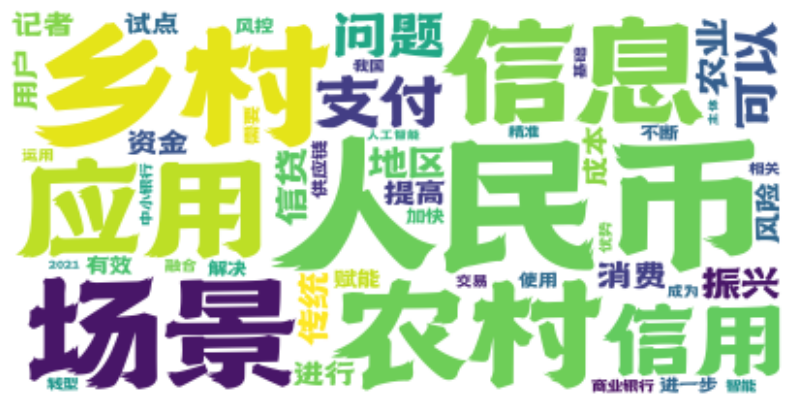

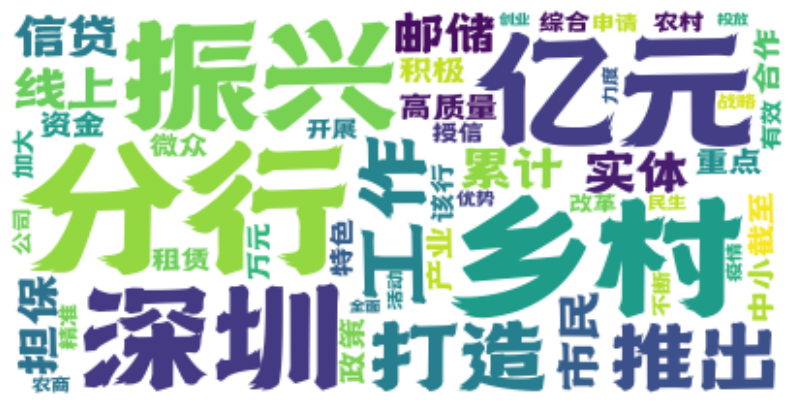

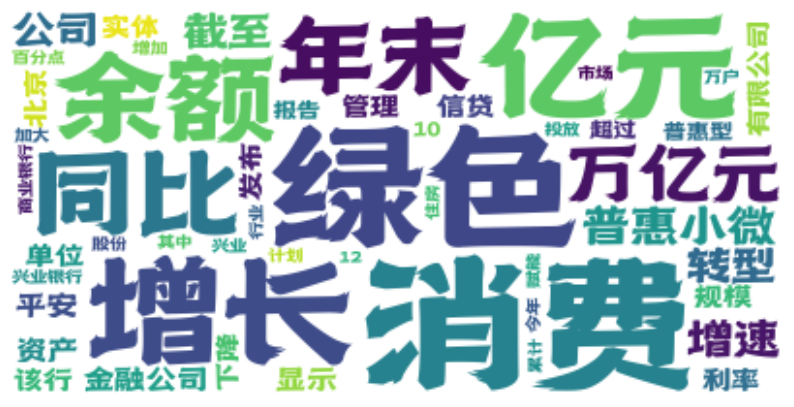

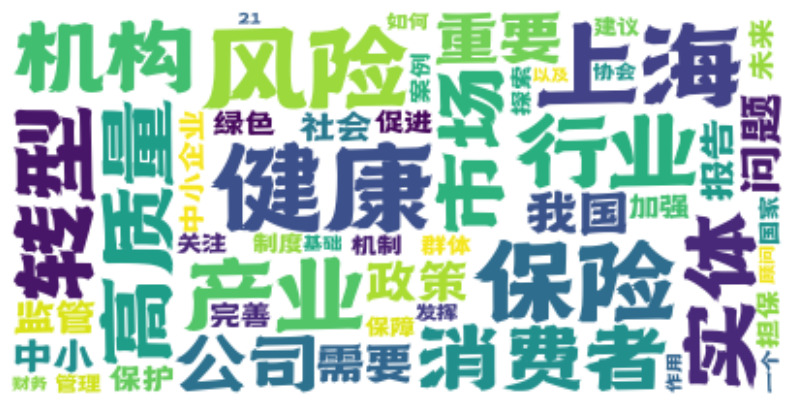

Topic #0:
人民币 场景 应用 转型 信息 问题 可以 农村 支付 乡村 成本 需要 信用 风险 风控 传统 进行 信贷 解决 供应链 赋能 融合 优势 记者 重要
Topic #1:
乡村 分行 振兴 亿元 深圳 农村 工作 信贷 资金 线上 担保 推出 政策 邮储 万元 积极 累计 信用 重点 截至 授信 开展 产业 市民 综合
Topic #2:
消费 绿色 公司 活动 行业 市民 案例 有限公司 金融公司 单位 生活 集团 社会 平安 兴业 股份 打造 担保 主题 消费者 上海 践行 用户 实体 场景
Topic #3:
健康 保险 上海 风险 政策 高质量 市场 我国 消费者 报告 中小 机构 产业 重要 机制 保护 实体 监管 完善 加强 制度 群体 中小企业 问题 保障
Topic #4:
增长 亿元 余额 同比 万亿元 年末 实体 微众 北京 普惠小微 截至 建行 增速 转型 绿色 管理 该行 高质量 资产 信贷 打造 规模 显示 万户 下降
Data written to E:\财经新闻爬虫\lda_result2\5\topic.txt successfully.


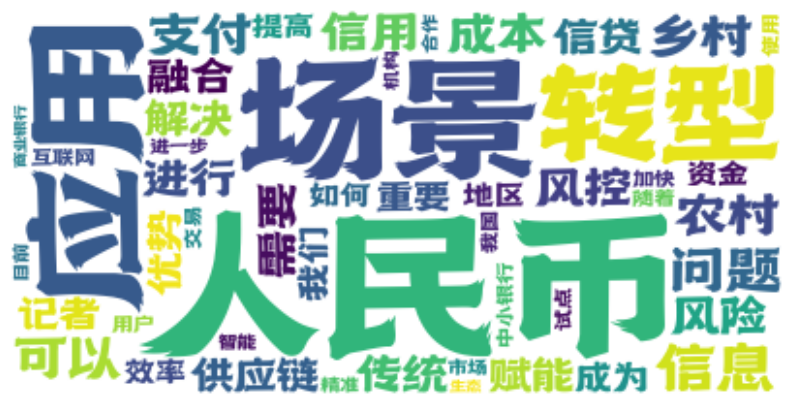

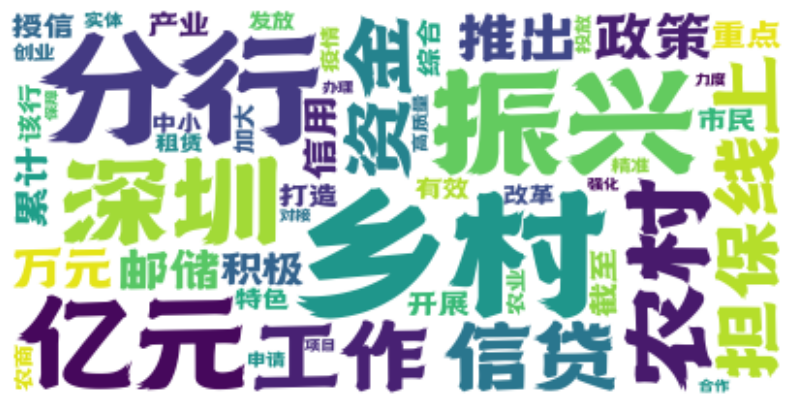

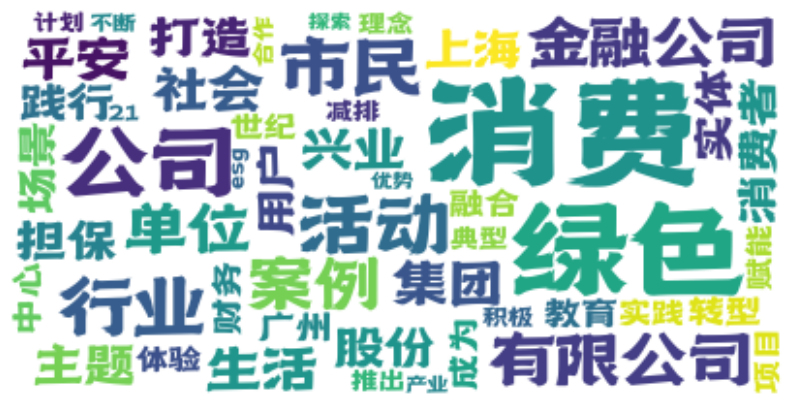

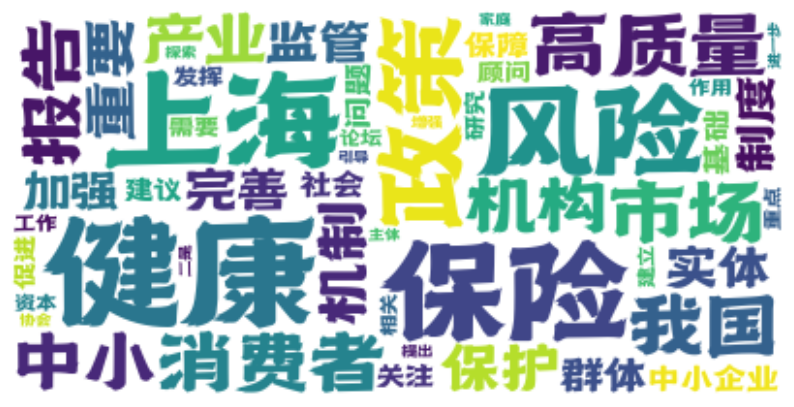

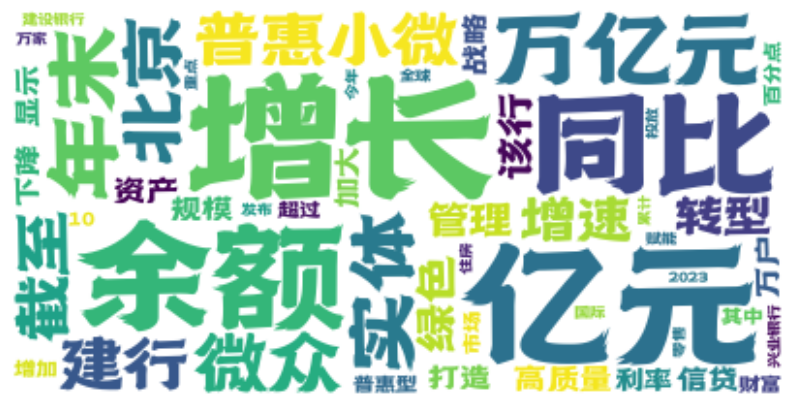

Topic #0:
人民币 场景 乡村 农村 应用 信息 支付 可以 信用 用户 供应链 传统 系统 进行 记者 赋能 问题 农业 智能 信贷 地区 风控 资金 优势 试点
Topic #1:
分行 乡村 振兴 亿元 深圳 工作 信贷 政策 资金 担保 万元 重点 加大 积极 累计 推出 中小 邮储 授信 该行 截至 租赁 改革 信用 市民
Topic #2:
消费 绿色 公司 市民 行业 案例 金融公司 有限公司 单位 担保 平安 活动 股份 兴业 集团 社会 乡村 财务 振兴 践行 减排 典型 esg 消费者 小额贷款
Topic #3:
上海 保险 顾问 活动 产业 保障 中心 开展 实体 宣传 知识 金融业 生活 工作 城市 上海市 重点 制度 教育 人群 线上 展示 群体 人民 进一步
Topic #4:
增长 亿元 余额 同比 万亿元 年末 实体 北京 转型 微众 管理 截至 建行 绿色 高质量 资产 打造 增速 该行 普惠小微 战略 规模 显示 万户 信贷
Topic #5:
风险 健康 问题 转型 我国 市场 政策 需要 报告 机构 重要 中小 高质量 监管 加强 产业 完善 消费者 机制 实体 基础 如何 促进 成本 中小企业
Data written to E:\财经新闻爬虫\lda_result2\6\topic.txt successfully.


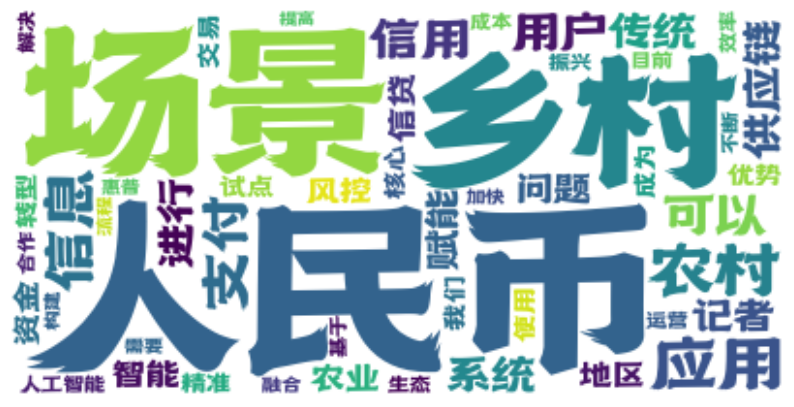

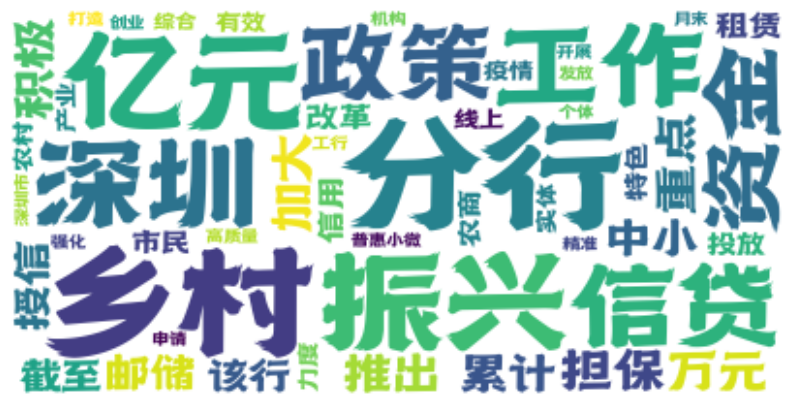

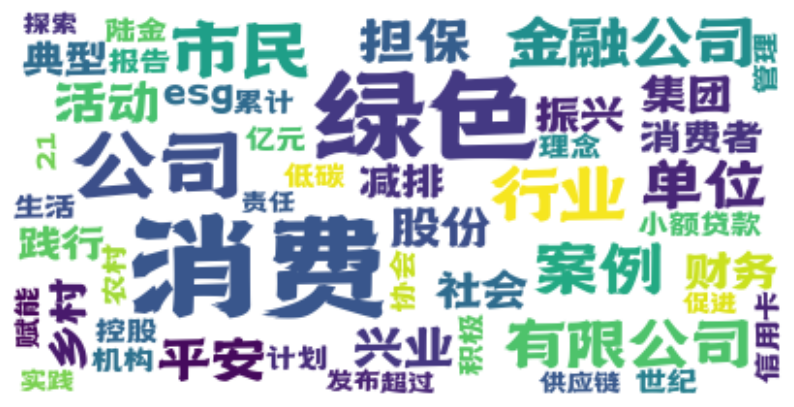

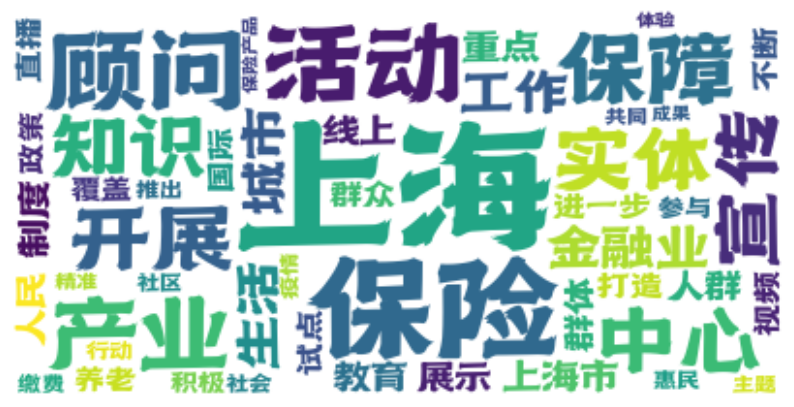

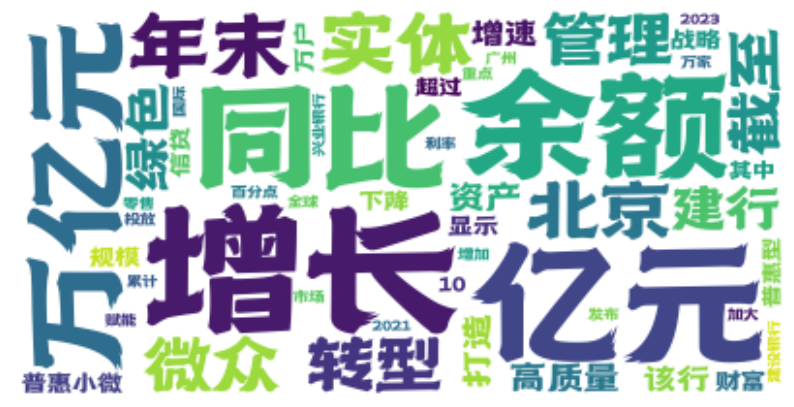

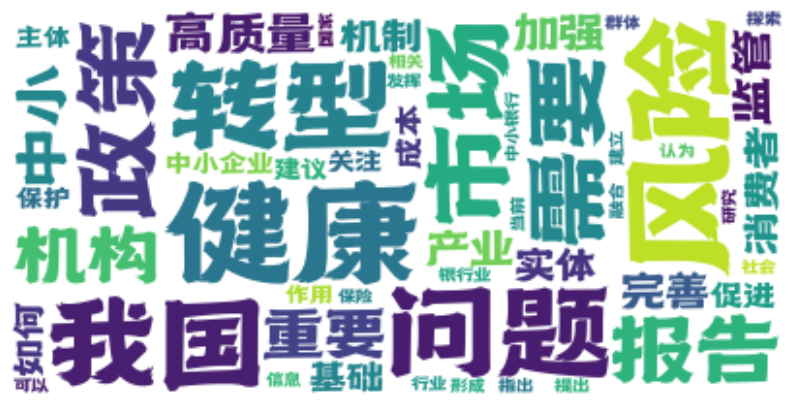

Topic #0:
人民币 场景 应用 可以 支付 风控 成本 信息 供应链 记者 用户 我们 问题 进行 资金 传统 商业银行 信贷 优势 使用 交易 需要 系统 目前 公司
Topic #1:
分行 亿元 信贷 政策 资金 深圳 万元 该行 中小 邮储 担保 累计 加大 推出 授信 工作 疫情 发放 农商 申请 截至 线上 投放 积极 力度
Topic #2:
消费 绿色 公司 市民 行业 金融公司 案例 单位 有限公司 担保 活动 平安 股份 社会 财务 消费者 集团 兴业 减排 典型 esg 租赁 践行 计划 小额贷款
Topic #3:
乡村 农村 振兴 农业 地区 信用 信息 农户 保险 工作 改革 县域 农民 产业 开展 保障 全国 基础 资源 知识 涉农 覆盖 重点 主体 脱贫
Topic #4:
上海 实体 打造 产业 高质量 转型 微众 合作 北京 场景 生态 管理 战略 金融业 构建 顾问 广州 深圳 优势 活动 财富 国际 万家 中心 不断
Topic #5:
健康 风险 问题 我国 转型 政策 机构 监管 报告 需要 中小 保险 重要 加强 高质量 消费者 市场 完善 机制 保护 基础 建议 主体 促进 作用
Topic #6:
增长 亿元 余额 同比 年末 万亿元 增速 普惠小微 截至 绿色 规模 资产 显示 转型 该行 信贷 下降 百分点 普惠型 万户 市场 利率 增加 加大 10
Data written to E:\财经新闻爬虫\lda_result2\7\topic.txt successfully.


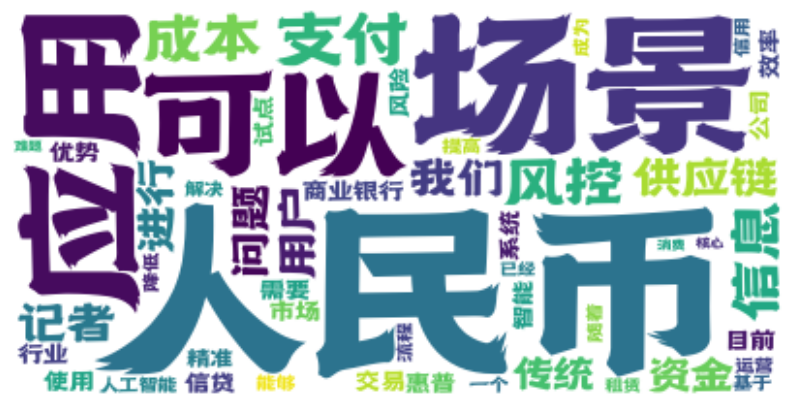

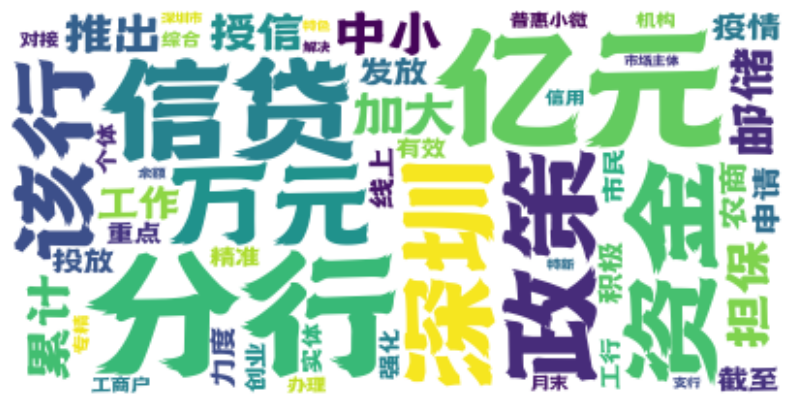

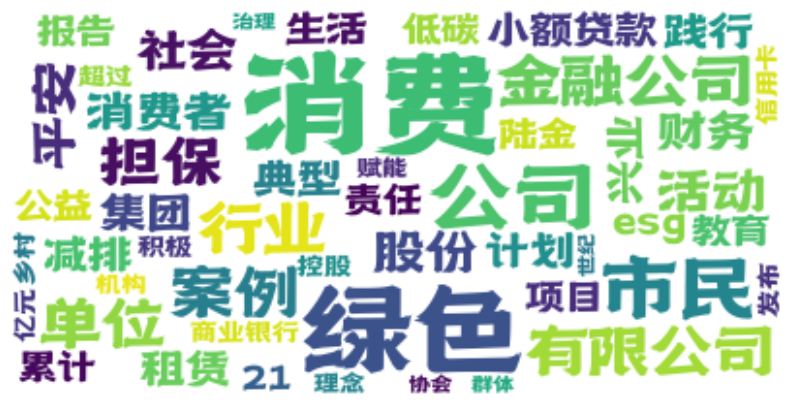

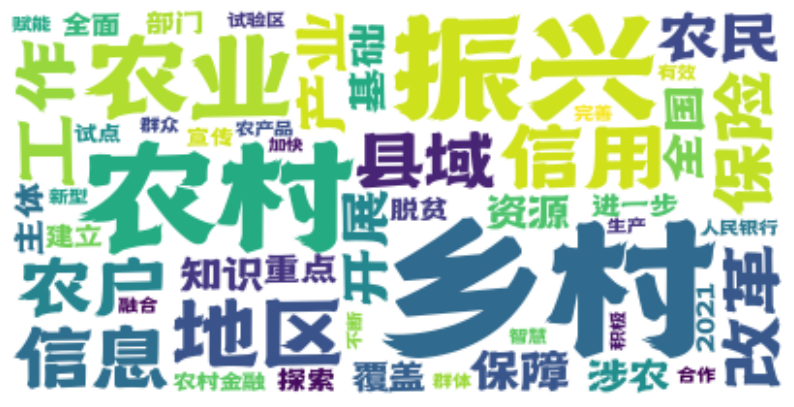

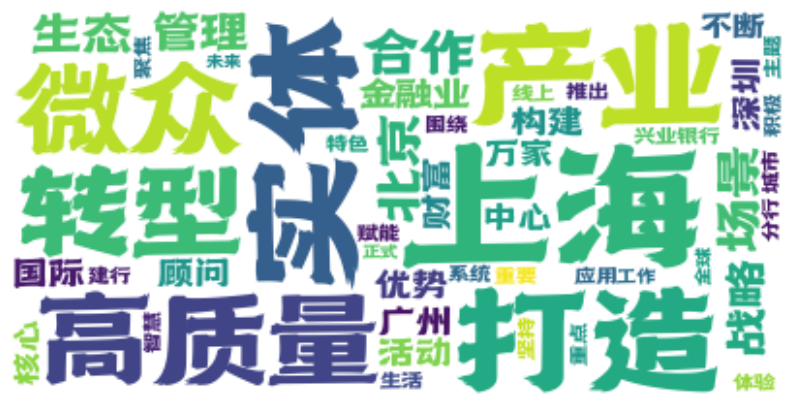

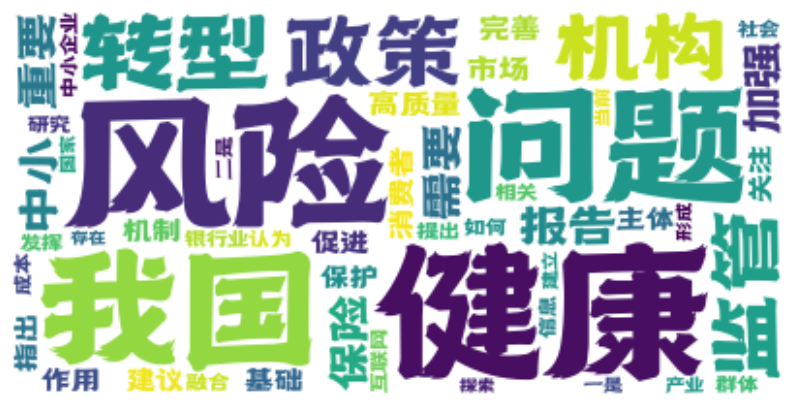

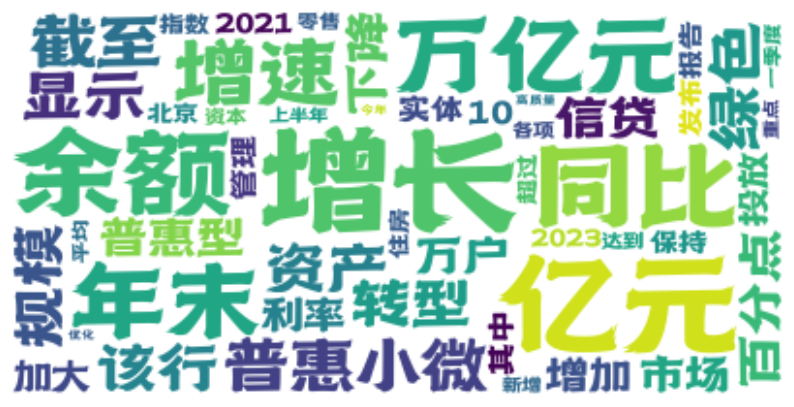

Topic #0:
人民币 场景 消费 应用 支付 可以 用户 记者 信息 市场 供应链 试点 使用 交易 行业 进行 目前 惠普 系统 我们 资金 风控 优势 运营 公司
Topic #1:
分行 亿元 深圳 邮储 资金 信贷 推出 万元 该行 担保 累计 线上 授信 中小 申请 农商 市民 截至 发放 政策 精准 实体 解决 创业 积极
Topic #2:
绿色 消费 公司 案例 金融公司 单位 有限公司 担保 行业 平安 市民 兴业 股份 乡村 财务 集团 减排 社会 esg 振兴 典型 活动 践行 小额贷款 低碳
Topic #3:
上海 保险 市民 顾问 保障 工作 活动 宣传 知识 开展 群体 上海市 制度 教育 政策 群众 进一步 重点 人群 中心 养老 直播 线上 产业 疫情
Topic #4:
实体 转型 打造 高质量 产业 微众 管理 战略 合作 生态 国际 场景 北京 核心 构建 财富 优势 重要 深圳 围绕 万家 金融业 全球 国家 坚持
Topic #5:
风险 健康 问题 需要 我国 中小 机构 报告 转型 政策 重要 监管 消费者 如何 成本 高质量 加强 保护 可以 中小银行 关注 解决 主体 存在 群体
Topic #6:
乡村 农村 振兴 农业 产业 信息 改革 信用 地区 工作 融合 市场 加快 完善 县域 农户 租赁 广州 全国 基础 转型 赋能 中小企业 信贷 全面
Topic #7:
增长 亿元 余额 同比 普惠小微 年末 万亿元 增速 建行 截至 信贷 加大 规模 该行 利率 普惠型 显示 万户 资产 百分点 投放 下降 北京 增加 住房
Data written to E:\财经新闻爬虫\lda_result2\8\topic.txt successfully.


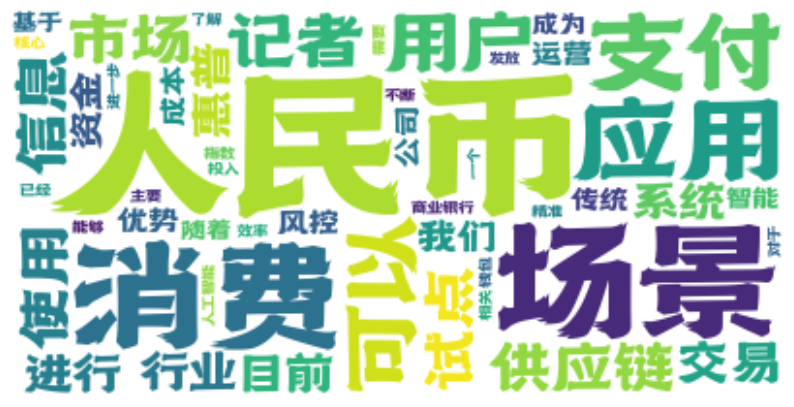

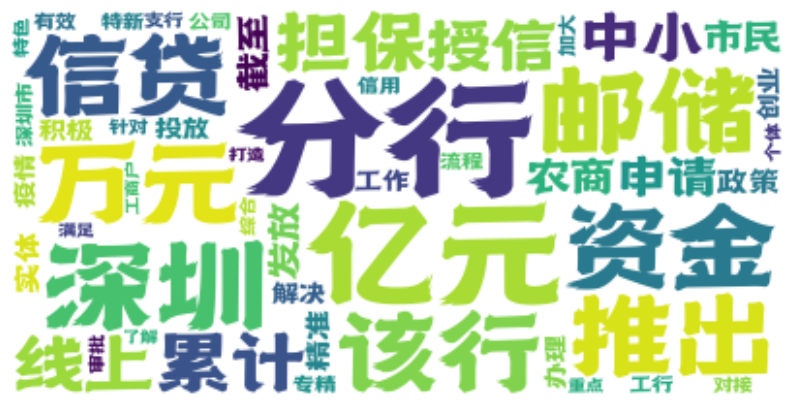

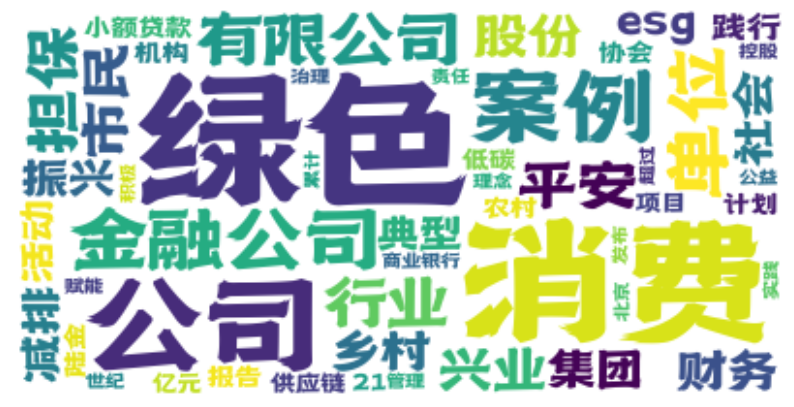

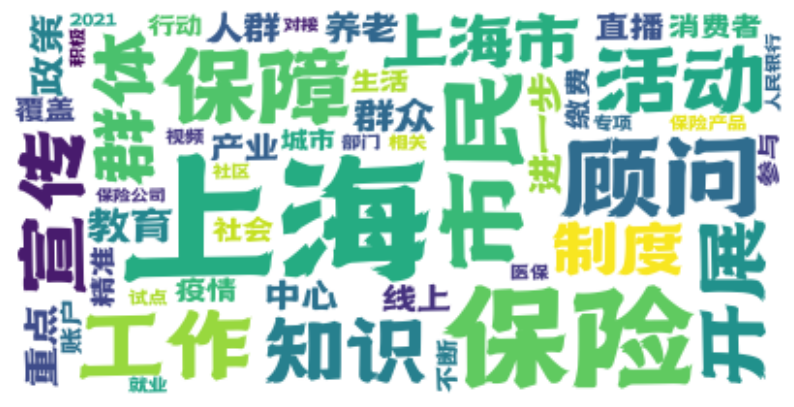

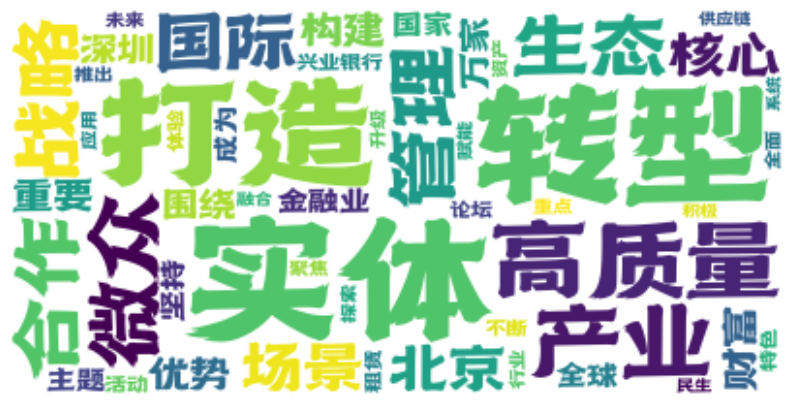

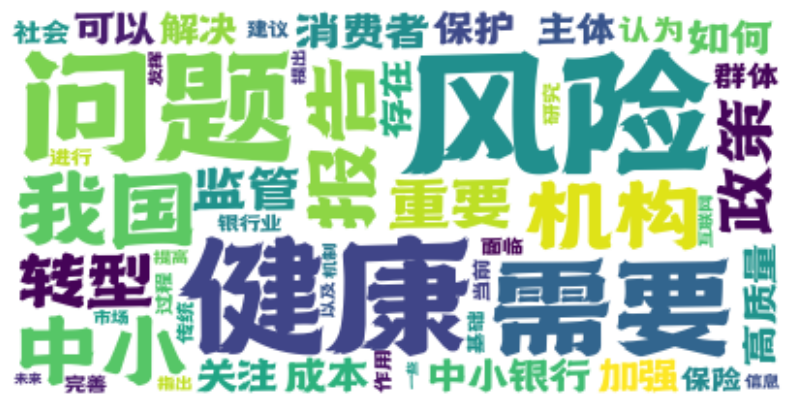

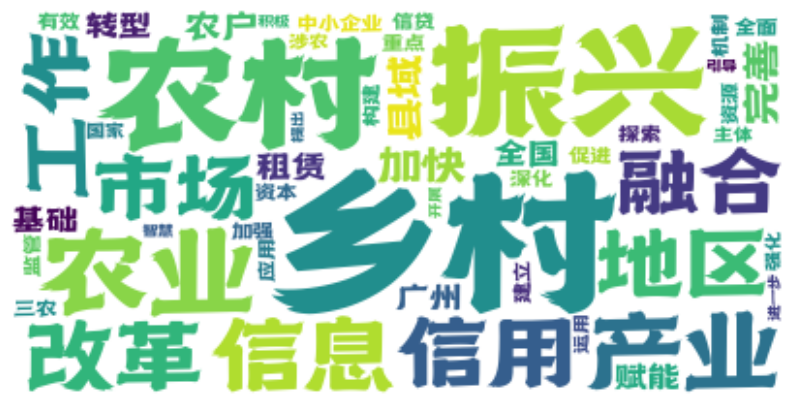

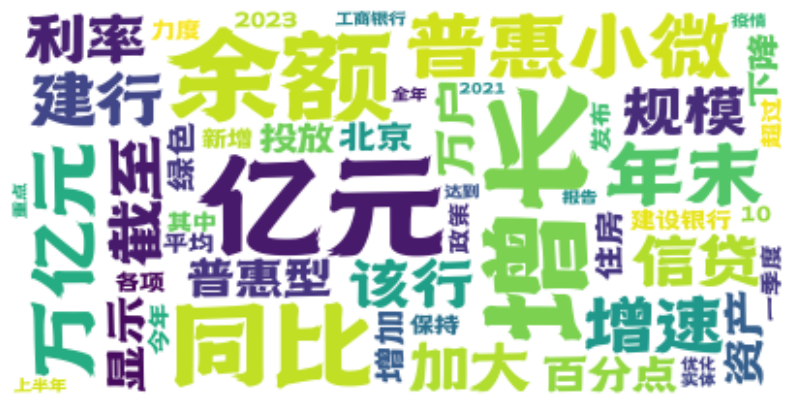

Topic #0:
人民币 场景 消费 支付 应用 用户 试点 记者 使用 交易 可以 发放 资金 政务 指数 钱包 城市 生活 信息 进行 结算 目前 住房 政府 落地
Topic #1:
分行 亿元 邮储 深圳 推出 资金 线上 累计 万元 该行 信贷 市民 担保 申请 授信 中小 截至 精准 农商 实体 解决 创业 积极 流程 办理
Topic #2:
消费 绿色 公司 案例 金融公司 担保 单位 有限公司 行业 市民 平安 兴业 股份 财务 集团 社会 减排 esg 典型 小额贷款 协会 乡村 践行 计划 低碳
Topic #3:
上海 保险 顾问 保障 活动 宣传 工作 开展 制度 上海市 知识 政策 产业 疫情 重点 进一步 直播 中心 行动 实体 养老 线上 精准 机构 视频
Topic #4:
打造 高质量 实体 微众 转型 北京 合作 战略 产业 管理 生态 财富 深圳 广州 国际 场景 构建 建行 兴业银行 围绕 主题 优势 核心 体验 特色
Topic #5:
健康 消费者 报告 群体 风险 保护 市民 保险 家庭 关注 社会 高质量 研究 我国 权益 政策 主体 问题 建议 人群 财务 加强 发布 伦理 目标
Topic #6:
乡村 农村 振兴 农业 信用 信息 地区 改革 工作 农户 租赁 县域 产业 基础 加快 三农 完善 机制 探索 全国 信贷 全面 主体 资源 有效
Topic #7:
亿元 增长 余额 同比 普惠小微 年末 万亿元 增速 截至 信贷 加大 利率 显示 投放 万户 该行 普惠型 规模 资产 下降 百分点 绿色 增加 政策 力度
Topic #8:
转型 风险 问题 市场 需要 成本 中小 重要 机构 行业 风控 信息 我国 可以 监管 产业 如何 实体 公司 中小企业 互联网 解决 应用 融合 面临
Data written to E:\财经新闻爬虫\lda_result2\9\topic.txt successfully.


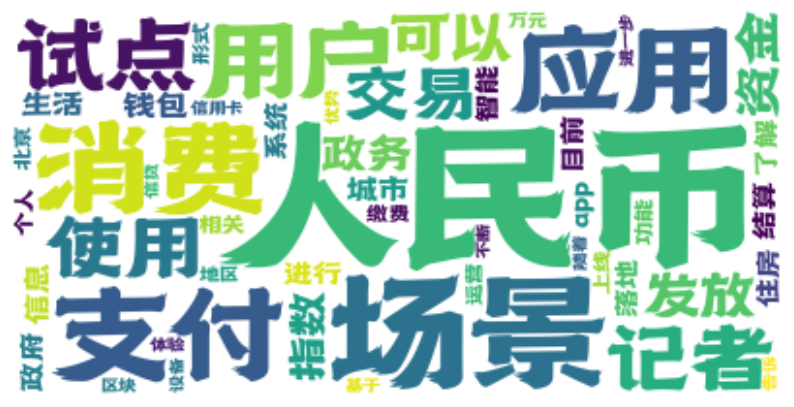

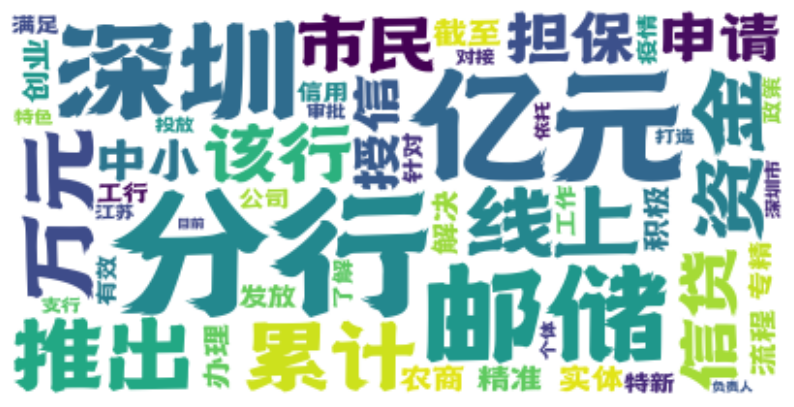

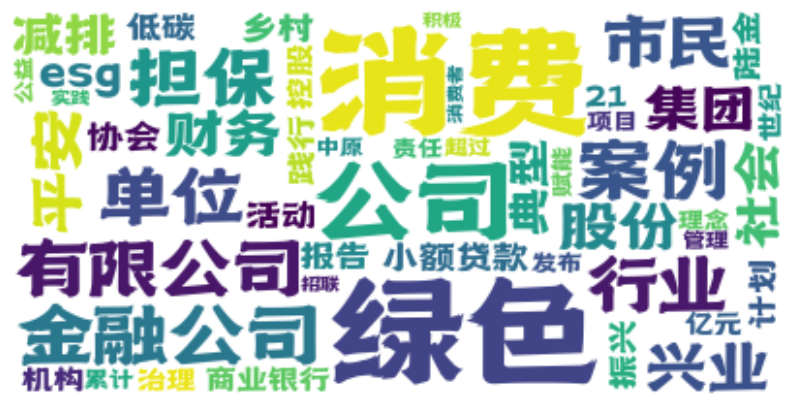

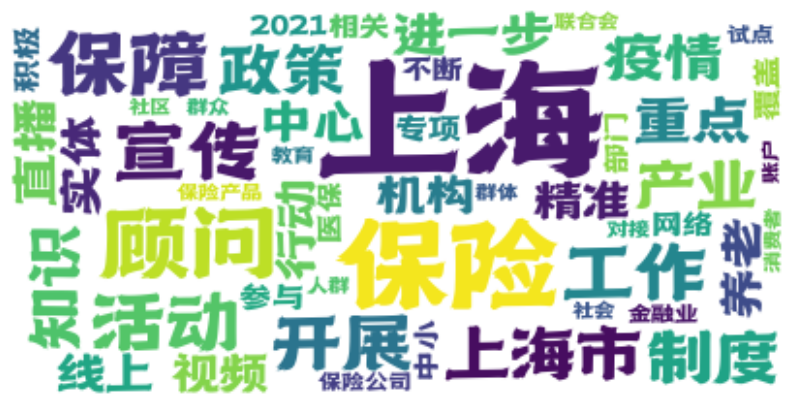

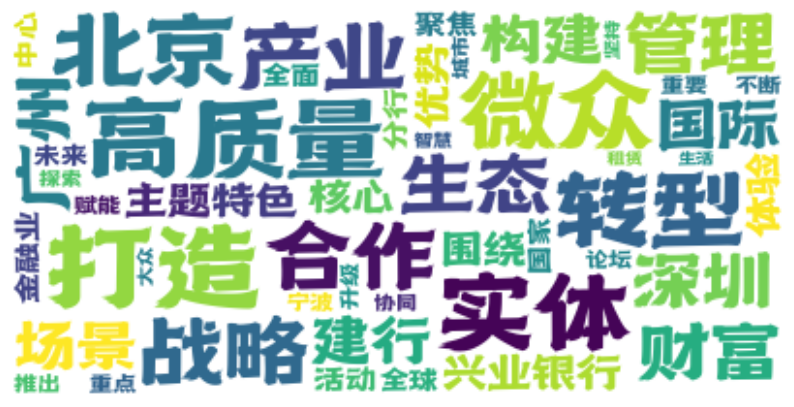

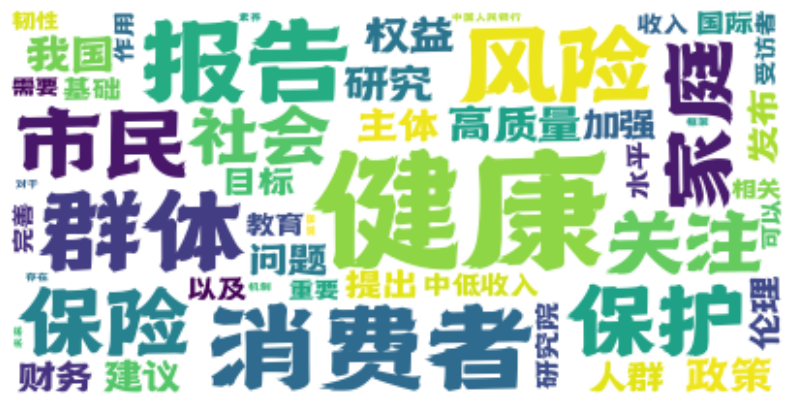

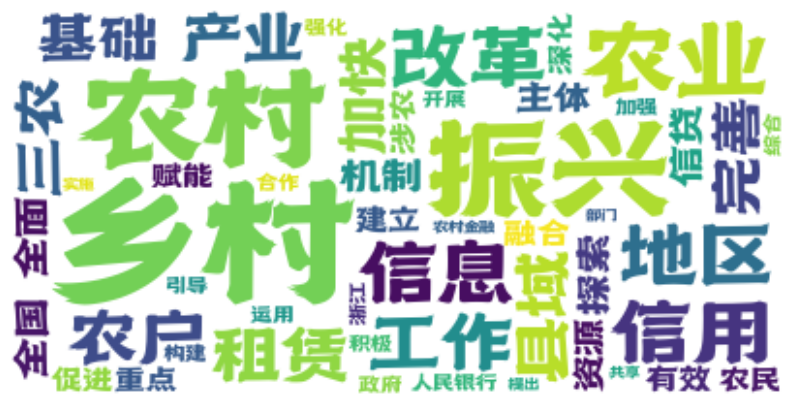

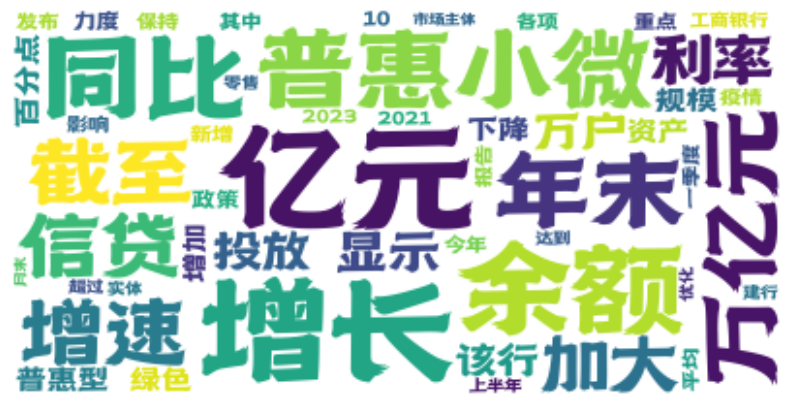

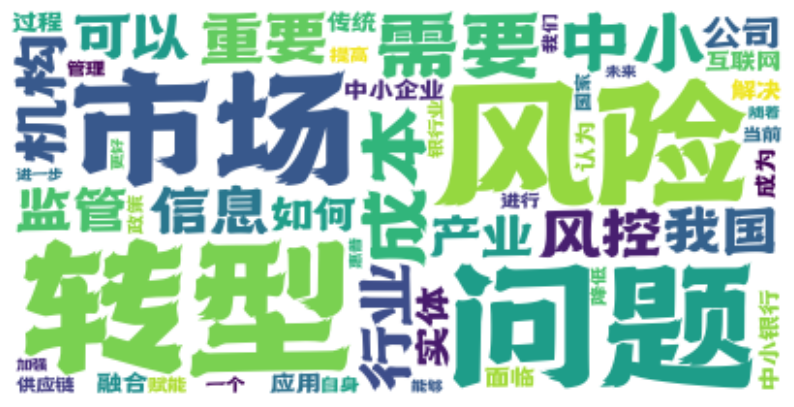

Topic #0:
乡村 农村 信息 可以 问题 振兴 信用 农业 需要 地区 传统 解决 商业银行 风险 成本 我们 进行 一个 用户 记者 惠普 农民 信贷 主体 县域
Topic #1:
亿元 分行 乡村 信贷 资金 振兴 工作 万元 政策 担保 累计 授信 邮储 该行 中小 截至 加大 农商 推出 疫情 积极 投放 发放 市民 重点
Topic #2:
消费 公司 绿色 市民 金融公司 担保 单位 案例 有限公司 行业 乡村 活动 股份 平安 财务 振兴 社会 减排 集团 消费者 典型 生活 农村 兴业 小额贷款
Topic #3:
上海 保险 顾问 保障 宣传 工作 开展 制度 知识 活动 产业 上海市 重点 进一步 政策 直播 试点 疫情 中心 部门 养老 专项 参与 相关 精准
Topic #4:
深圳 微众 高质量 实体 打造 合作 战略 产业 国际 管理 财富 全球 优势 广州 金融业 大众 重要 国家 活动 主题 推出 成立 围绕 我们 聚焦
Topic #5:
健康 消费者 报告 风险 群体 保护 市民 家庭 保险 社会 关注 权益 高质量 研究 我国 财务 政策 主体 伦理 中低收入 教育 建议 问题 目标 发布
Topic #6:
增长 亿元 余额 同比 年末 万亿元 增速 普惠小微 截至 绿色 租赁 显示 资产 规模 下降 百分点 该行 普惠型 转型 利率 万户 投放 信贷 加大 增加
Topic #7:
场景 北京 建行 打造 线上 赋能 信息 智慧 政务 兴业银行 建设银行 转型 应用 生态 综合 推出 生活 体验 智能 分行 宁波 系统 构建 信贷 升级
Topic #8:
转型 绿色 风险 产业 市场 监管 中小 行业 机构 实体 融合 问题 应用 重要 供应链 我国 中小企业 加强 需要 成本 完善 促进 国家 政策 银行业
Topic #9:
人民币 支付 场景 应用 试点 改革 乡村 发放 邮储 钱包 振兴 万家 使用 浙江 资金 探索 交易 落地 结算 记者 消费 方案 试验区 苏州 生态
Data written to E:\财经新闻爬虫\lda_result2\10\topic.txt successfully.


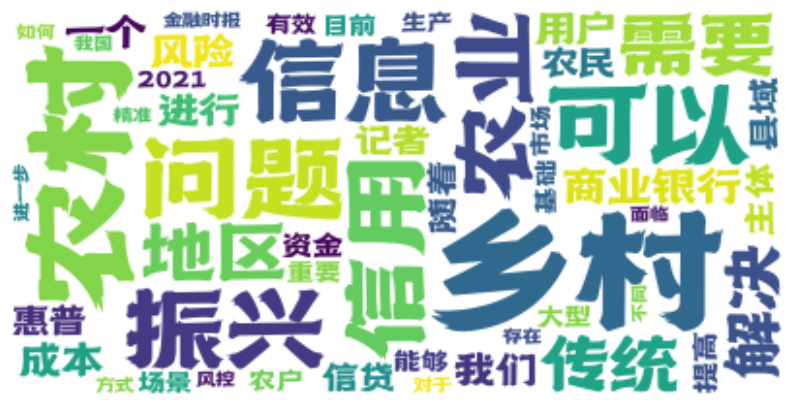

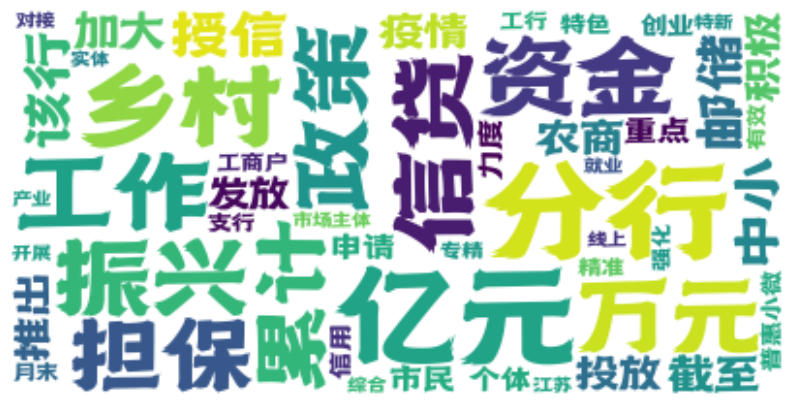

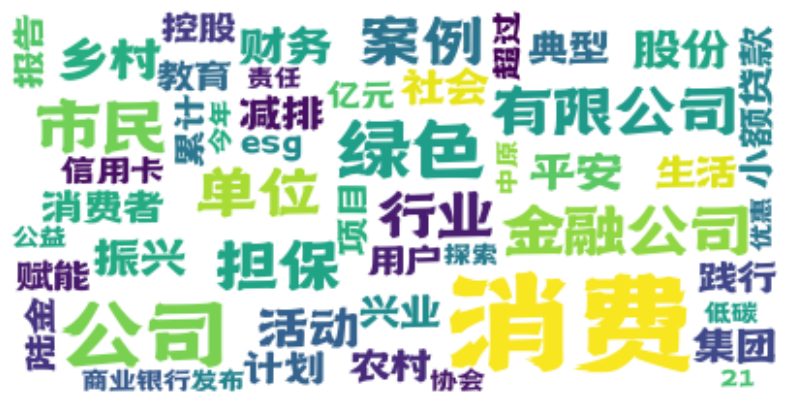

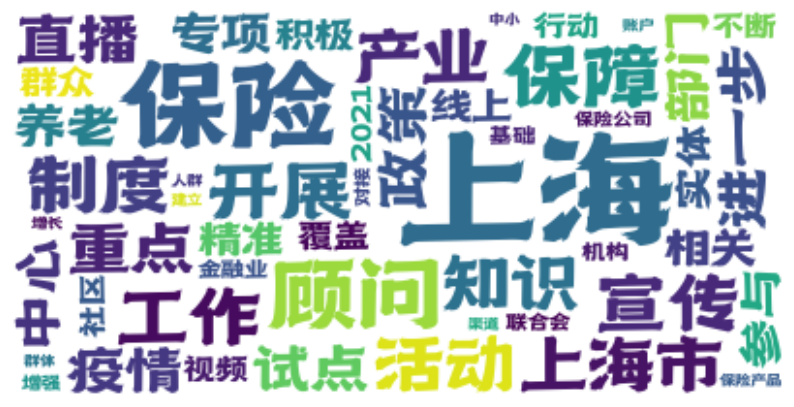

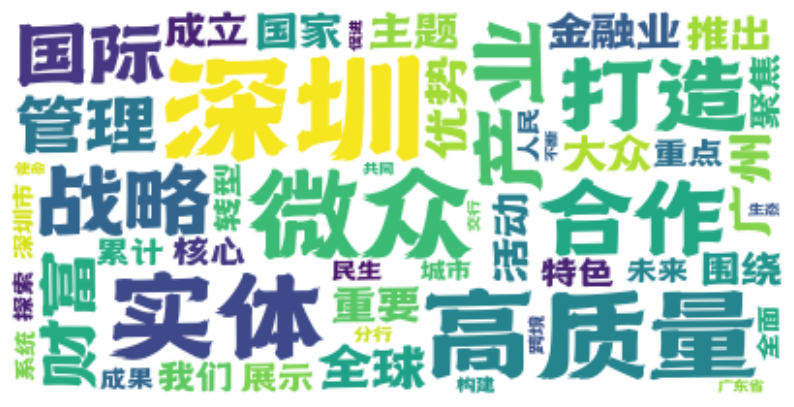

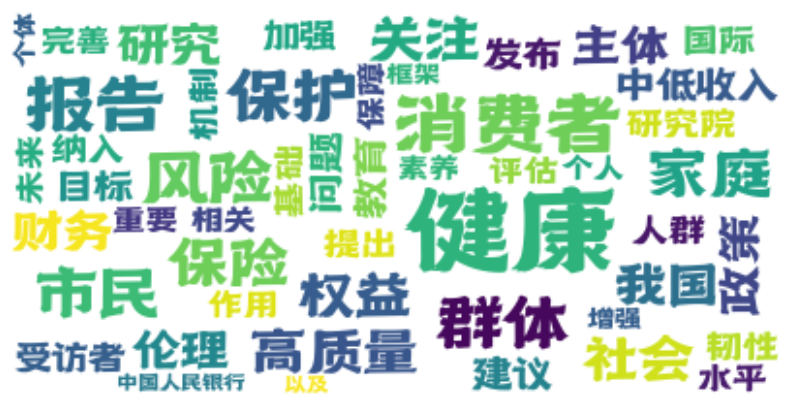

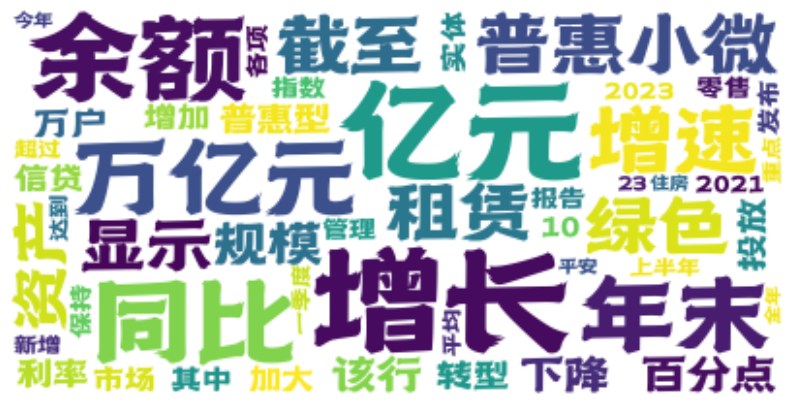

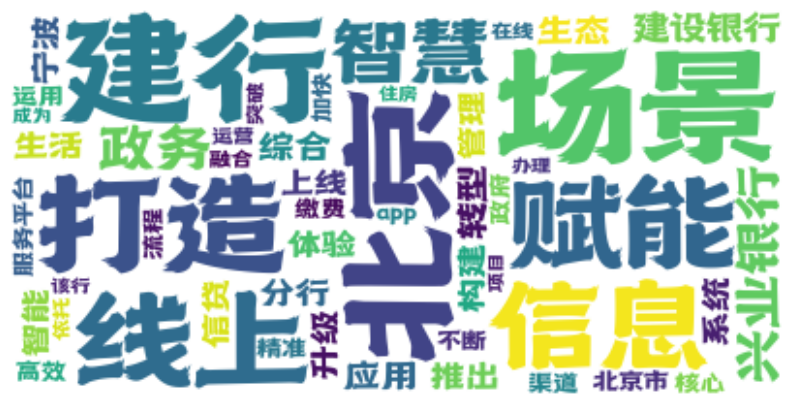

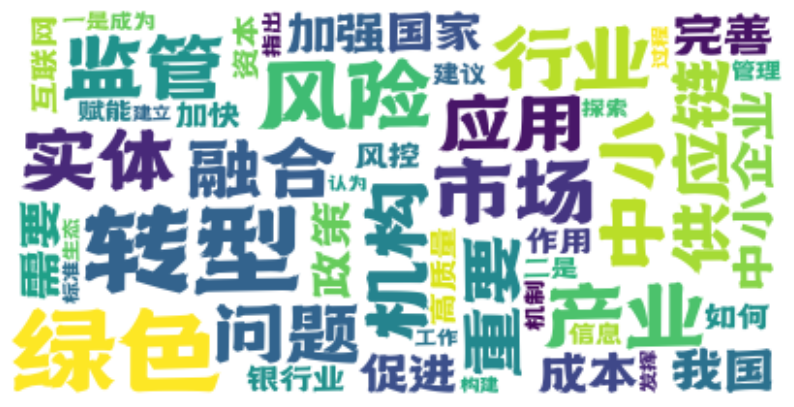

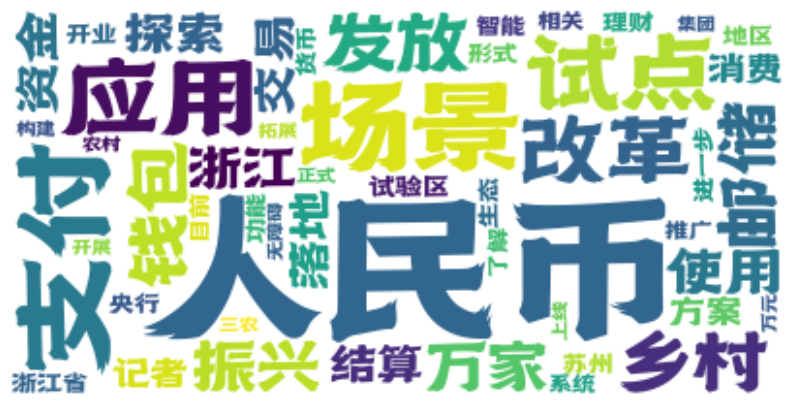

Topic #0:
可以 问题 需要 风险 成本 信息 传统 解决 风控 进行 我们 市场 用户 一个 商业银行 场景 能够 如何 目前 随着 重要 惠普 记者 成为 提高
Topic #1:
分行 亿元 深圳 万元 该行 累计 推出 邮储 市民 截至 实体 农商 资金 授信 申请 线上 专精 深圳市 特新 信贷 特色 打造 支行 发放 高质量
Topic #2:
消费 公司 担保 市民 金融公司 案例 有限公司 单位 行业 股份 财务 平安 典型 兴业 乡村 小额贷款 集团 农村 振兴 21 陆金 控股 消费者 世纪 机构
Topic #3:
上海 保险 顾问 保障 活动 宣传 工作 开展 制度 上海市 知识 产业 重点 直播 实体 中心 行动 疫情 养老 参与 政策 进一步 社会 视频 金融业
Topic #4:
微众 打造 高质量 北京 实体 合作 管理 财富 战略 转型 生态 场景 体验 生活 国际 主题 优势 推出 活动 宁波 构建 全球 围绕 不断 核心
Topic #5:
健康 报告 消费者 群体 保护 风险 保险 家庭 社会 关注 权益 我国 研究 高质量 政策 主体 建议 发布 财务 市民 中低收入 伦理 基础 研究院 目标
Topic #6:
乡村 振兴 农村 农业 地区 改革 信用 租赁 信息 农户 工作 县域 产业 三农 基础 有效 农民 加快 主体 全国 资源 探索 全面 涉农 完善
Topic #7:
中小 建行 信贷 普惠小微 政策 工行 信息 市场主体 疫情 加大 兴业银行 精准 工商户 个体 机构 线上 担保 力度 信用 资金 工具 综合 进一步 工作 对接
Topic #8:
转型 产业 绿色 实体 市场 风险 监管 行业 中小企业 融合 机构 中小 高质量 重要 应用 供应链 加强 我国 国家 促进 问题 资本 完善 银行业 互联网
Topic #9:
人民币 场景 支付 应用 试点 邮储 发放 钱包 万家 使用 交易 消费 资金 落地 结算 记者 开业 智能 苏州 形式 系统 央行 功能 用户 了解
Topic #10:
绿色 增长 亿元 余额 同比 年末 万亿元 截至 增速 显示 资产 规模 百分点 该行 普惠小微 下降 普惠型 报告 10 利率 转型 万户 投放 增加 信贷
Data written to E:\财经新闻爬

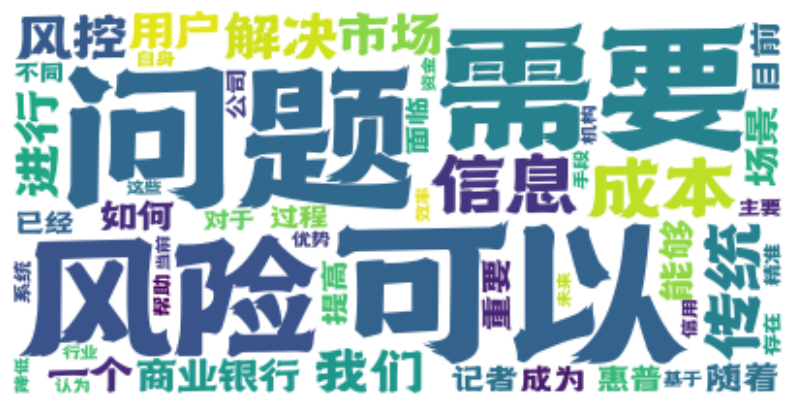

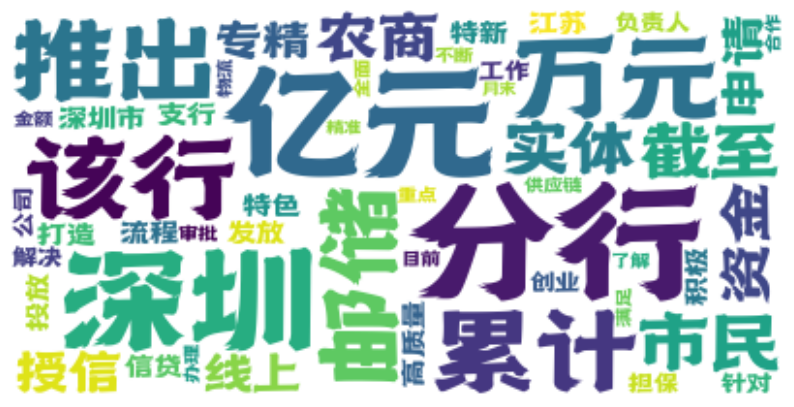

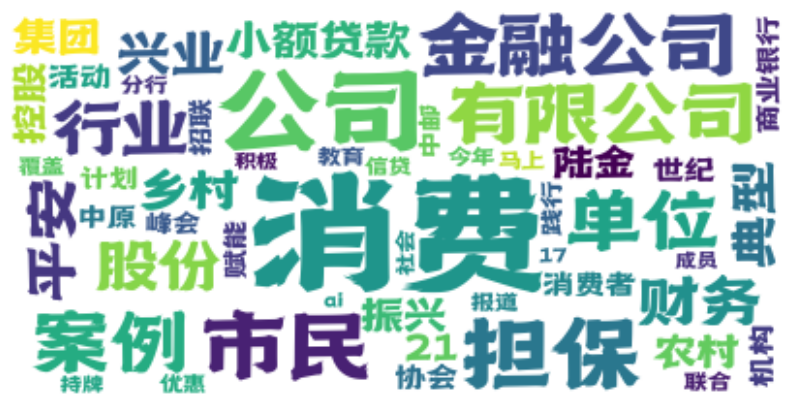

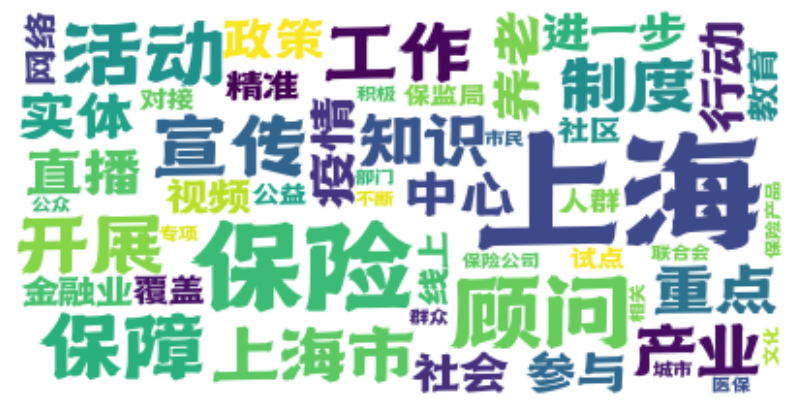

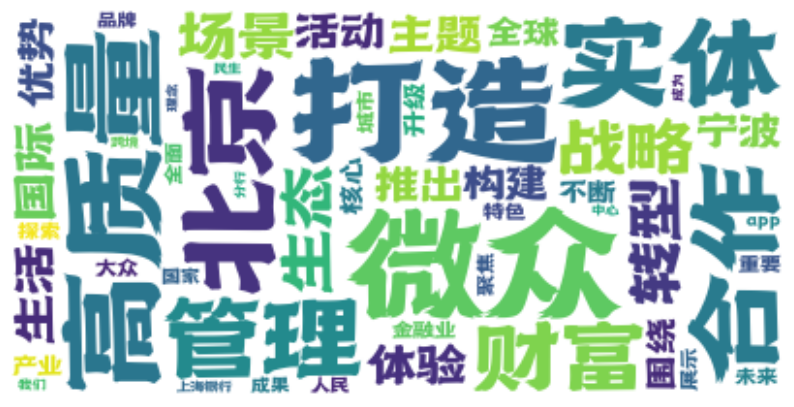

...

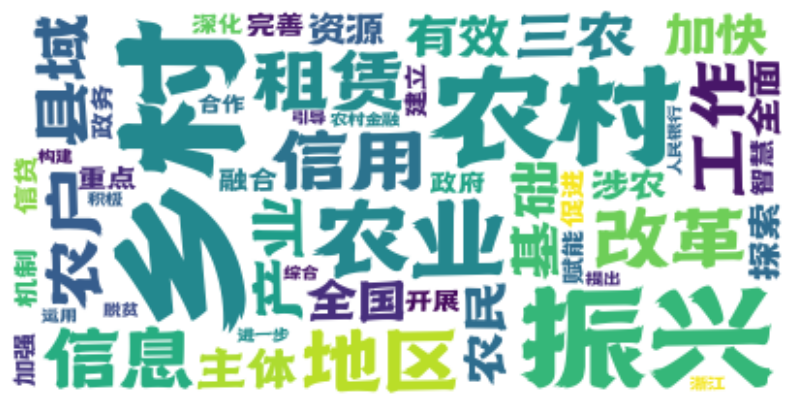

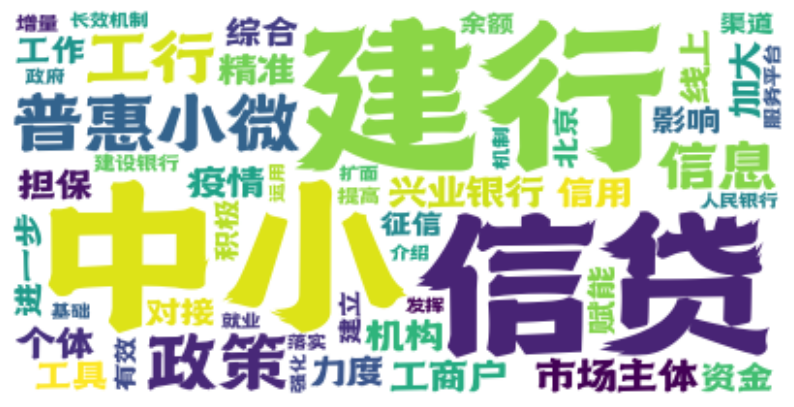

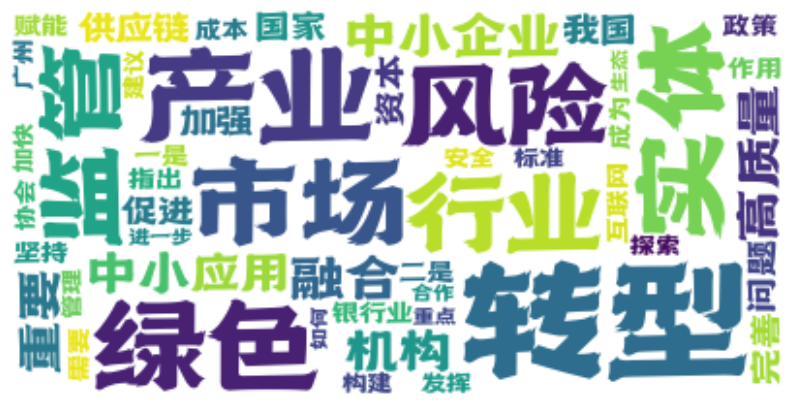

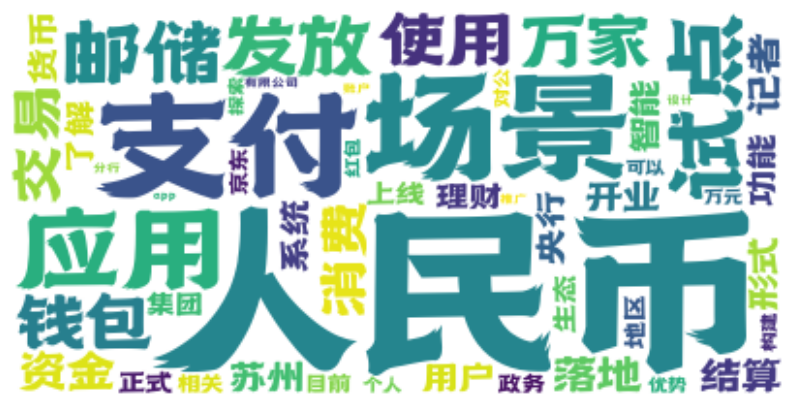

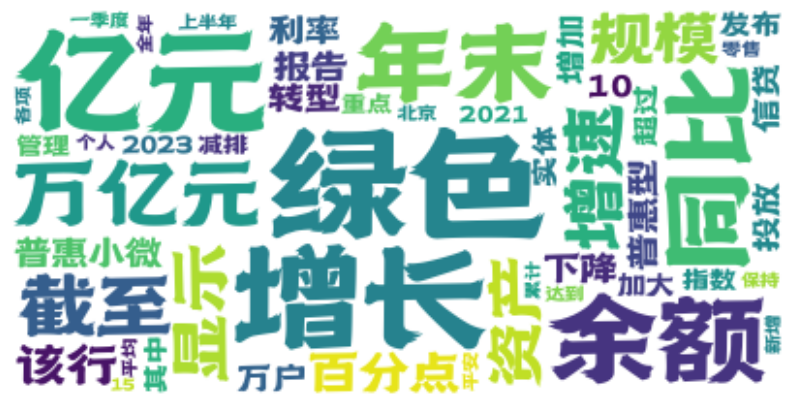

Topic #0:
问题 可以 需要 风险 成本 传统 解决 风控 信息 场景 进行 我们 用户 一个 商业银行 能够 如何 重要 记者 目前 市场 成为 随着 对于 过程
Topic #1:
分行 亿元 深圳 万元 累计 该行 资金 邮储 推出 信贷 市民 申请 截至 授信 实体 担保 农商 发放 政策 创业 专精 工作 投放 中小 特新
Topic #2:
消费 公司 市民 担保 金融公司 案例 有限公司 单位 行业 股份 平安 财务 典型 小额贷款 集团 兴业 21 陆金 控股 活动 消费者 协会 机构 计划 世纪
Topic #3:
上海 保险 顾问 保障 活动 宣传 工作 开展 上海市 制度 知识 产业 重点 政策 疫情 进一步 直播 实体 养老 群体 精准 市民 人群 线上 金融业
Topic #4:
微众 高质量 打造 实体 战略 管理 合作 财富 转型 深圳 国际 产业 北京 优势 广州 全球 主题 围绕 体验 核心 金融业 生态 构建 全面 活动
Topic #5:
健康 消费者 报告 保护 群体 风险 家庭 关注 保险 社会 研究 高质量 权益 我国 主体 政策 财务 建议 中低收入 研究院 伦理 发布 教育 市民 受访者
Topic #6:
乡村 振兴 农村 农业 地区 改革 信用 租赁 农户 信息 县域 工作 产业 三农 农民 探索 基础 涉农 加快 全面 资源 主体 全国 开展 有效
Topic #7:
建行 场景 线上 信息 兴业银行 政务 北京 赋能 中小 综合 建设银行 宁波 智慧 政府 打造 住房 信用 工行 服务平台 北京市 分行 缴费 办理 精准 生活
Topic #8:
转型 产业 风险 实体 监管 中小 机构 行业 融合 加强 供应链 我国 问题 重要 应用 高质量 完善 促进 国家 政策 银行业 二是 市场 成本 一是
Topic #9:
人民币 支付 场景 应用 试点 邮储 发放 钱包 万家 使用 消费 资金 落地 交易 结算 苏州 开业 记者 形式 货币 央行 智能 生态 理财 功能
Topic #10:
增长 亿元 余额 同比 普惠小微 年末 万亿元 增速 截至 信贷 加大 显示 普惠型 利率 规模 资产 投放 该行 百分点 万户 增加 绿色 报告 政策 重点
Topic #11:
绿色 市场 惠普 中小企业 减排 

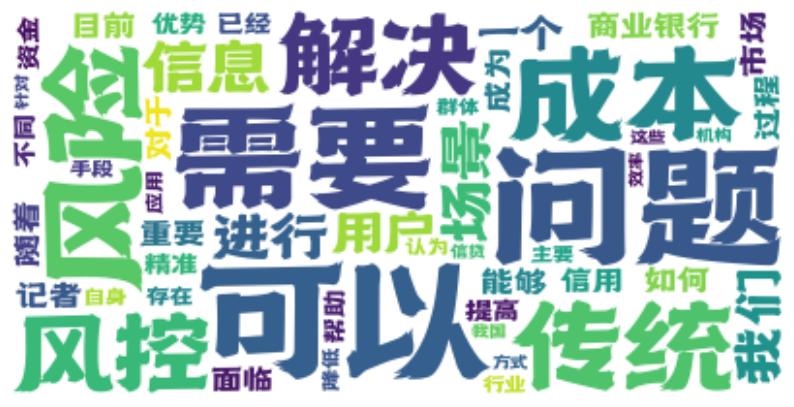

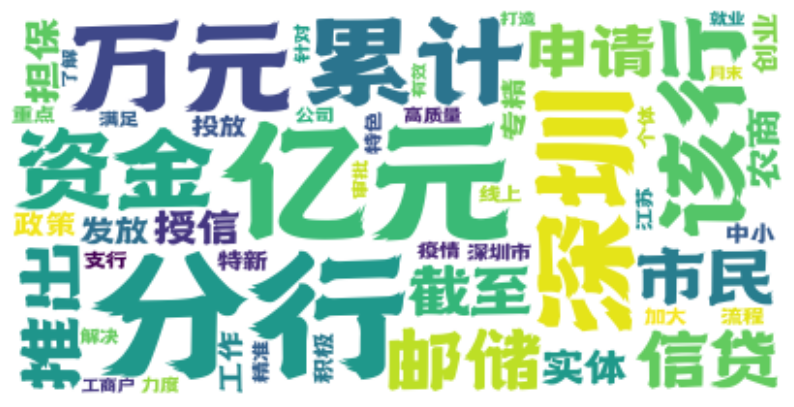

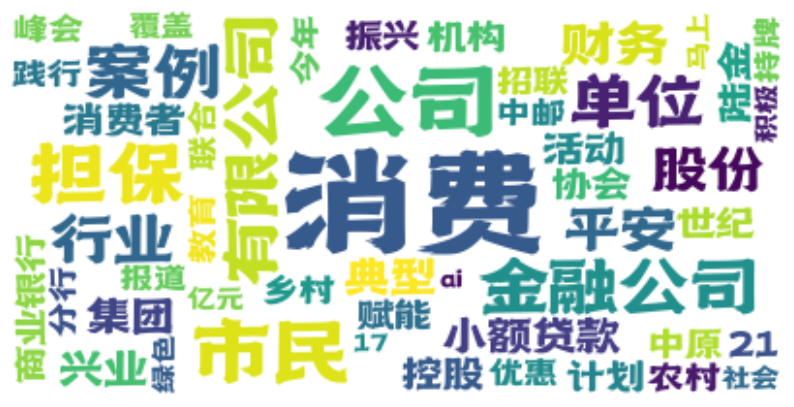

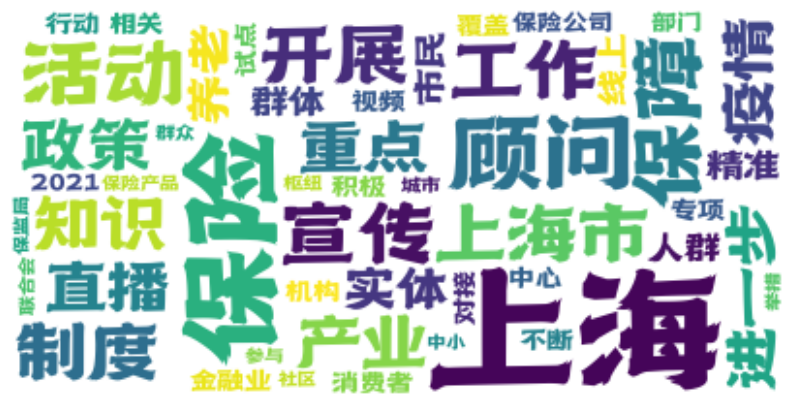

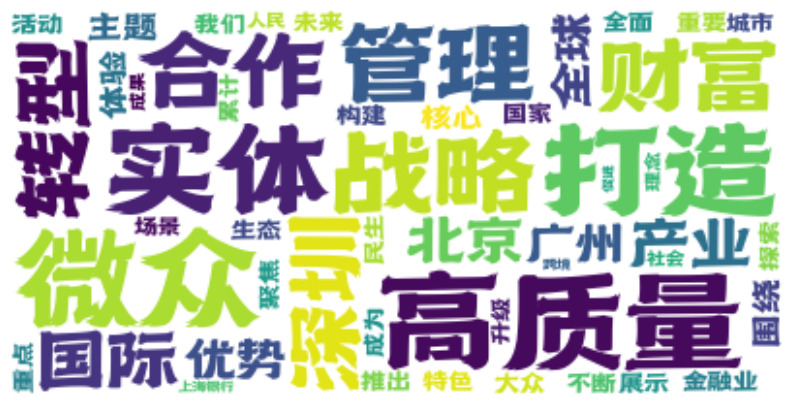

...

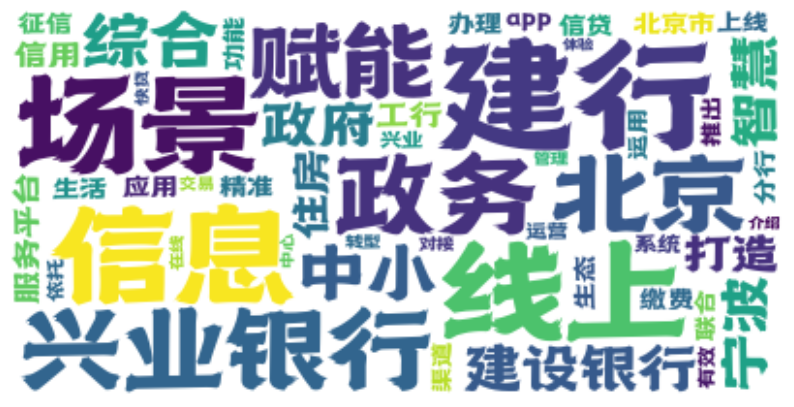

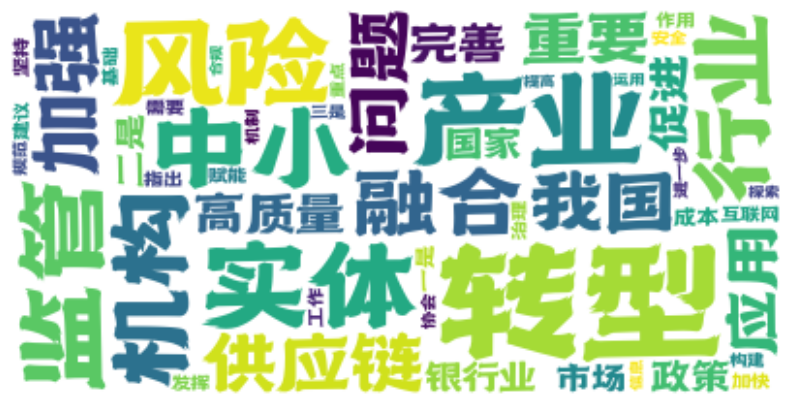

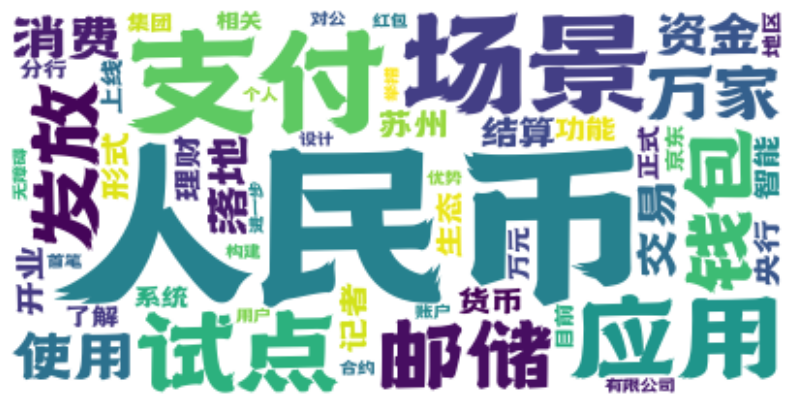

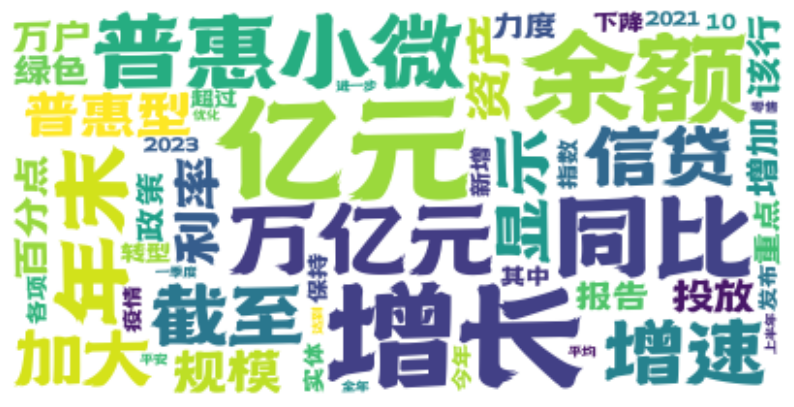

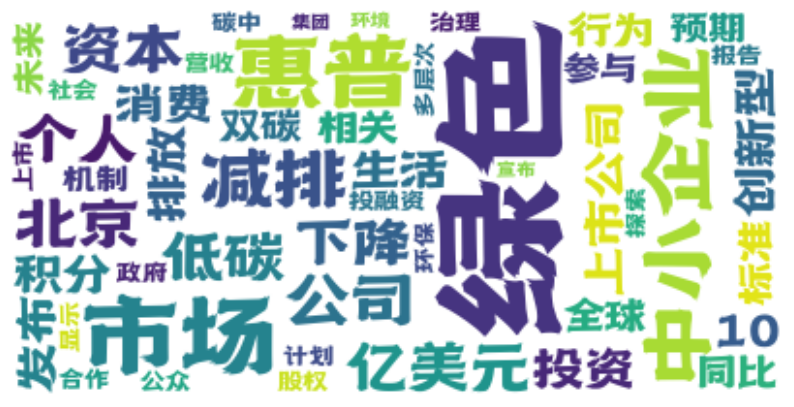

Topic #0:
问题 可以 风险 需要 成本 信息 解决 传统 进行 风控 一个 我们 重要 信用 如何 商业银行 能够 市场 过程 提高 记者 面临 机构 资金 随着
Topic #1:
分行 亿元 深圳 万元 资金 累计 该行 邮储 信贷 授信 推出 担保 中小 实体 申请 截至 政策 发放 农商 市民 专精 创业 工作 疫情 投放
Topic #2:
担保 公司 案例 单位 有限公司 股份 财务 21 世纪 典型 集团 协会 行业 小额贷款 乡村 农村 报道 机构 振兴 市民 商业银行 峰会 分行 17 研究院
Topic #3:
上海 保险 顾问 保障 制度 上海市 工作 宣传 产业 政策 开展 进一步 重点 养老 试点 精准 中小 保监局 对接 机构 专项 知识 活动 部门 实体
Topic #4:
微众 高质量 实体 打造 深圳 战略 合作 国际 管理 财富 产业 全球 转型 主题 金融业 优势 我们 北京 围绕 大众 国家 展示 重点 核心 重要
Topic #5:
健康 消费者 报告 群体 风险 保护 家庭 保险 社会 关注 研究 高质量 权益 我国 政策 财务 主体 建议 中低收入 伦理 研究院 市民 发布 教育 受访者
Topic #6:
乡村 振兴 农村 农业 地区 租赁 改革 信用 信息 县域 农户 工作 三农 产业 农民 探索 基础 资源 涉农 全国 开展 全面 加快 有效 重点
Topic #7:
建行 场景 线上 北京 兴业银行 政务 信息 打造 赋能 工行 综合 智慧 建设银行 宁波 分行 推出 生态 北京市 生活 应用 上线 转型 住房 缴费 广州
Topic #8:
转型 产业 监管 实体 融合 风险 加强 高质量 行业 应用 中小 促进 我国 完善 机构 供应链 重要 加快 治理 问题 国家 政策 赋能 市场 构建
Topic #9:
人民币 支付 场景 应用 试点 邮储 发放 钱包 使用 万家 资金 落地 交易 结算 记者 苏州 开业 形式 消费 智能 货币 生态 央行 京东 了解
Topic #10:
增长 亿元 余额 同比 普惠小微 年末 万亿元 增速 信贷 截至 加大 普惠型 利率 规模 资产 显示 投放 百分点 该行 万户 增加 绿色 力度 政策 保持
Topic #11:
绿色 市场 惠普 中小企业 减排 公司 

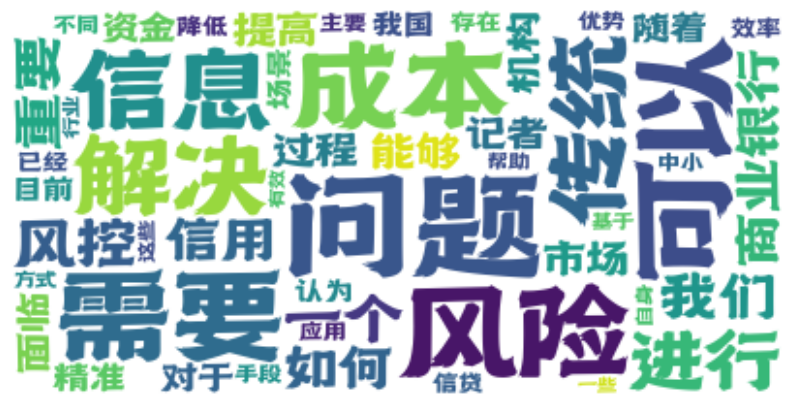

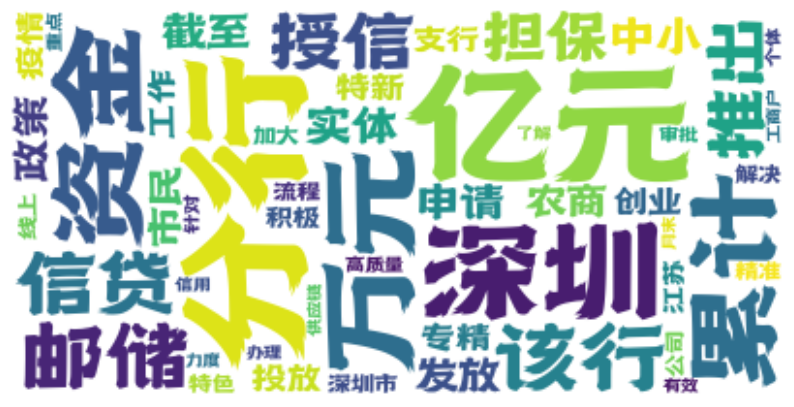

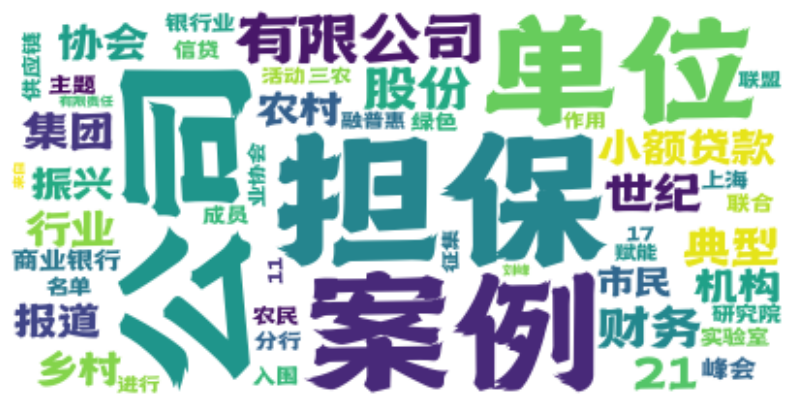

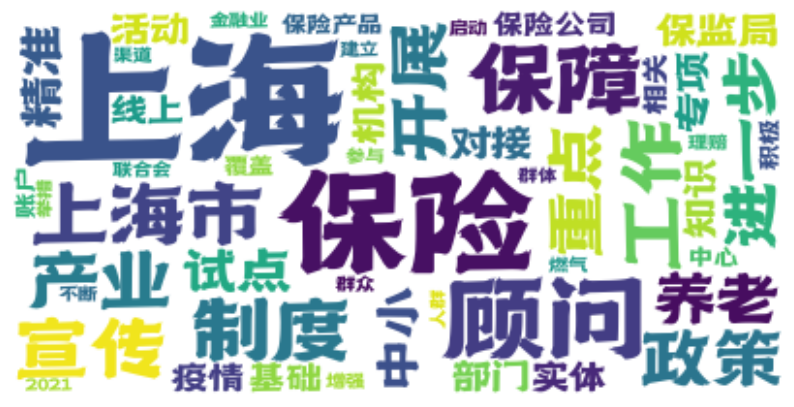

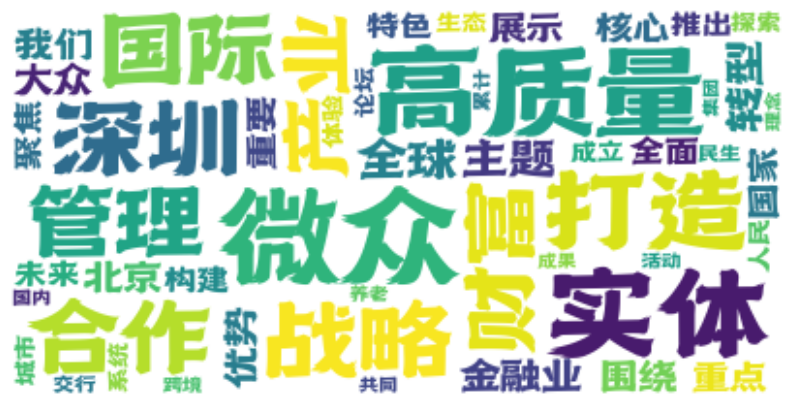

...

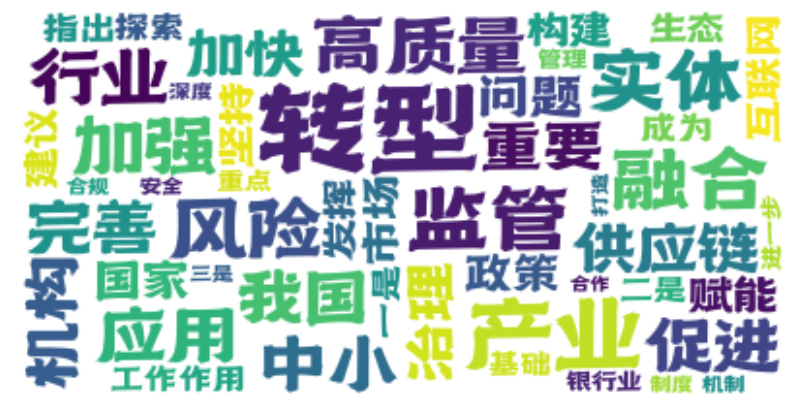

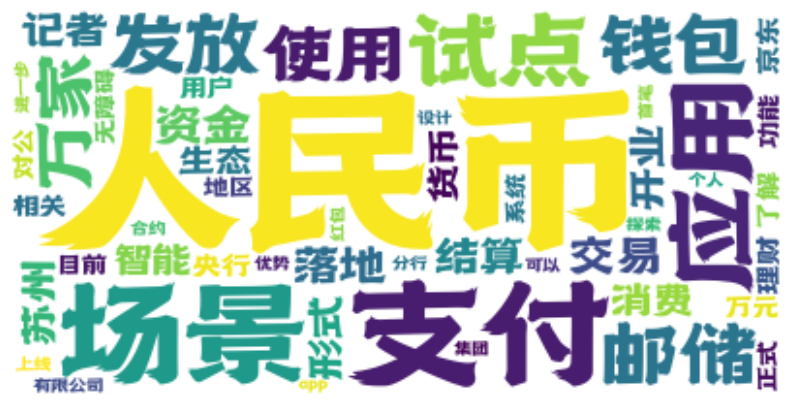

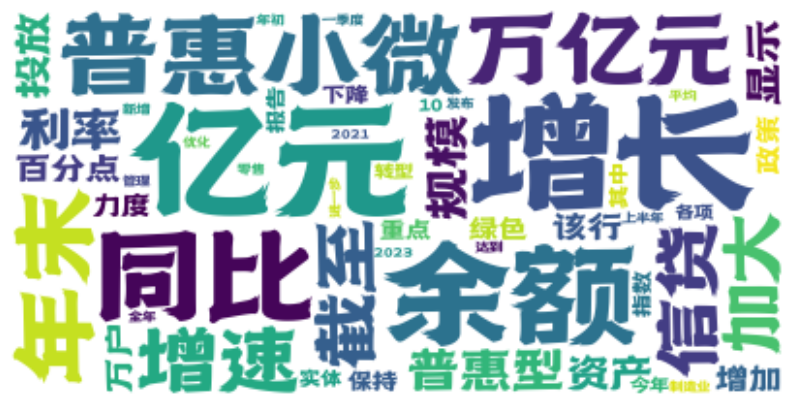

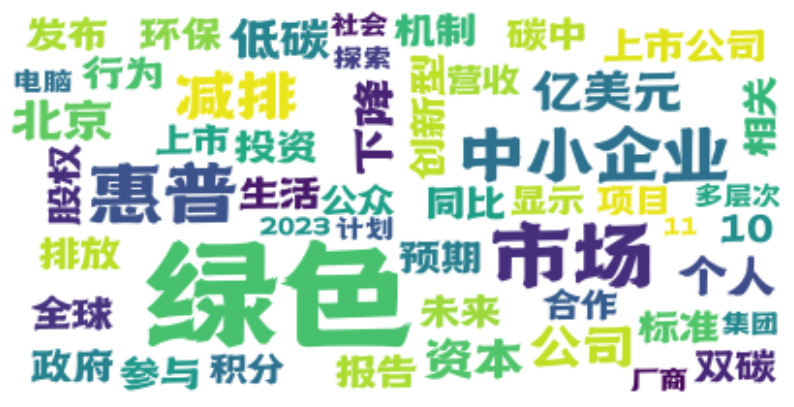

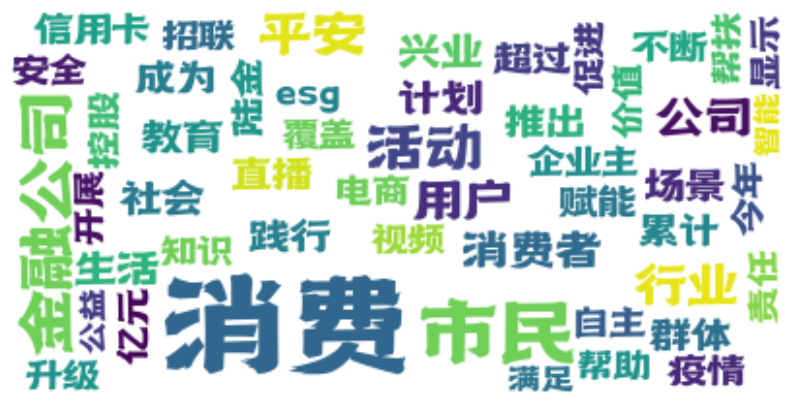

Topic #0:
可以 问题 成本 我们 一个 记者 市场 需要 解决 用户 信息 风险 信用 能够 指数 目前 情况 对于 已经 政策 资金 进行 信贷 这些 疫情
Topic #1:
分行 亿元 资金 万元 该行 信贷 累计 担保 推出 政策 中小 邮储 授信 申请 线上 市民 截至 发放 工行 农商 创业 投放 疫情 专精 精准
Topic #2:
公司 担保 案例 有限公司 单位 股份 21 财务 世纪 典型 协会 集团 行业 小额贷款 报道 乡村 农村 振兴 机构 市民 商业银行 峰会 分行 研究院 17
Topic #3:
上海 保险 顾问 保障 上海市 制度 产业 工作 实体 开展 重点 政策 进一步 精准 专项 试点 金融业 养老 疫情 宣传 中小 保险公司 线上 保险产品 部门
Topic #4:
深圳 微众 高质量 实体 打造 产业 战略 合作 国际 全球 国家 活动 主题 金融业 重点 全面 围绕 重要 转型 聚焦 展示 优势 特色 大众 我们
Topic #5:
健康 消费者 报告 风险 群体 保护 家庭 保险 社会 关注 权益 高质量 我国 研究 主体 人群 政策 市民 财务 中低收入 建议 伦理 素养 发布 目标
Topic #6:
乡村 农村 振兴 农业 地区 改革 信息 信用 租赁 工作 农户 县域 农民 基础 三农 产业 探索 主体 机制 全国 全面 加快 完善 资源 涉农
Topic #7:
建行 北京 广州 场景 兴业银行 政务 打造 赋能 线上 建设银行 宁波 综合 生活 分行 信息 智慧 生态 app 住房 北京市 缴费 中心 应用 体验 广州市
Topic #8:
转型 风险 问题 中小 产业 监管 应用 实体 机构 我国 重要 供应链 需要 行业 融合 成本 互联网 信息 促进 过程 加强 赋能 如何 完善 高质量
Topic #9:
人民币 支付 场景 应用 试点 钱包 发放 使用 交易 落地 结算 消费 资金 形式 货币 苏州 信用卡 央行 记者 功能 用户 万元 京东 无障碍 邮储
Topic #10:
增长 亿元 余额 同比 年末 万亿元 普惠小微 增速 截至 信贷 加大 绿色 资产 普惠型 规模 该行 百分点 显示 投放 万户 增加 实体 利率 报告 重点
Topic #11:
绿色 市场 惠普 中小企业 减

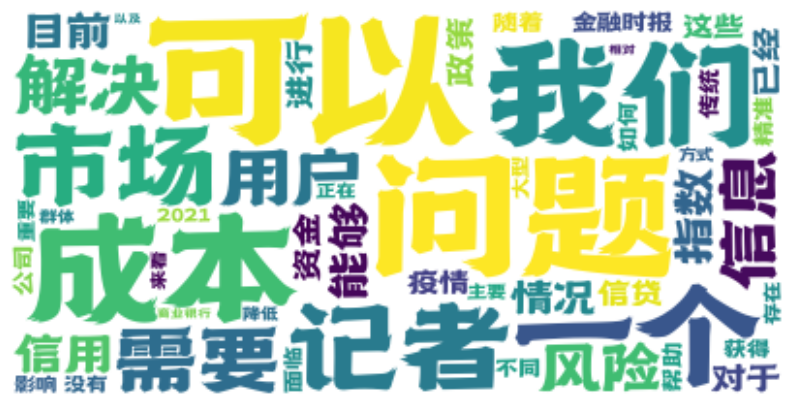

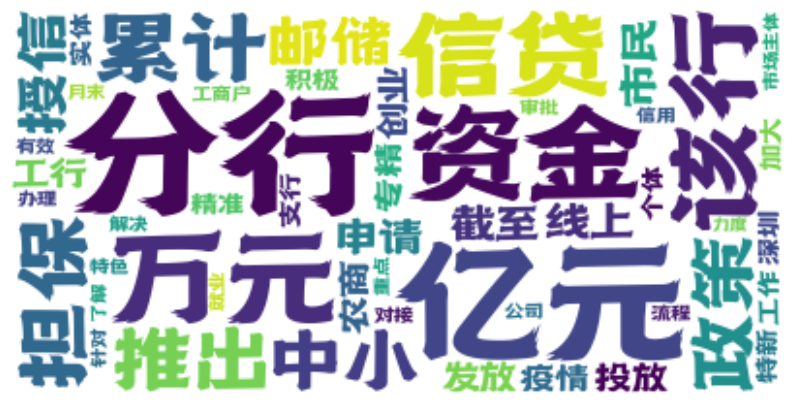

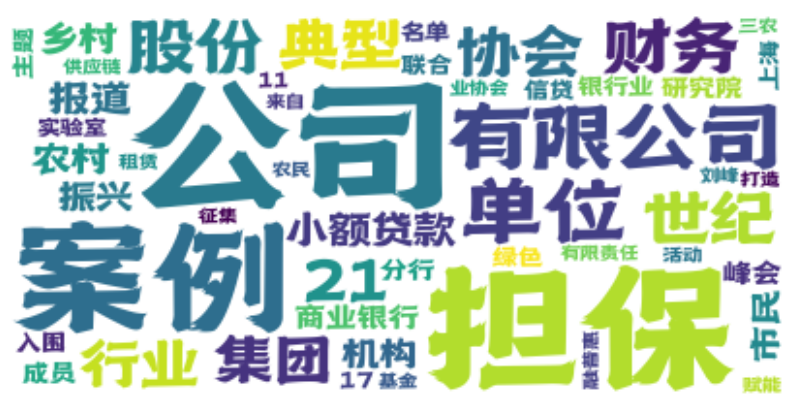

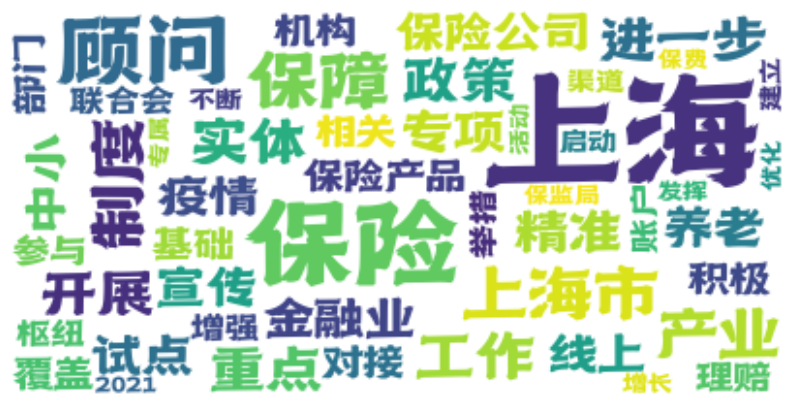

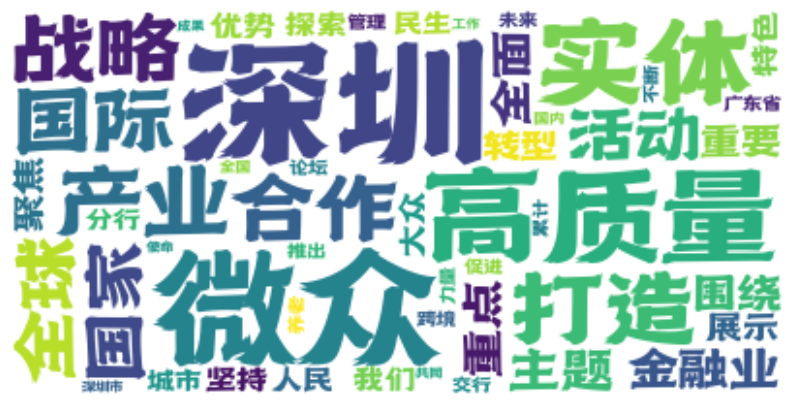

...

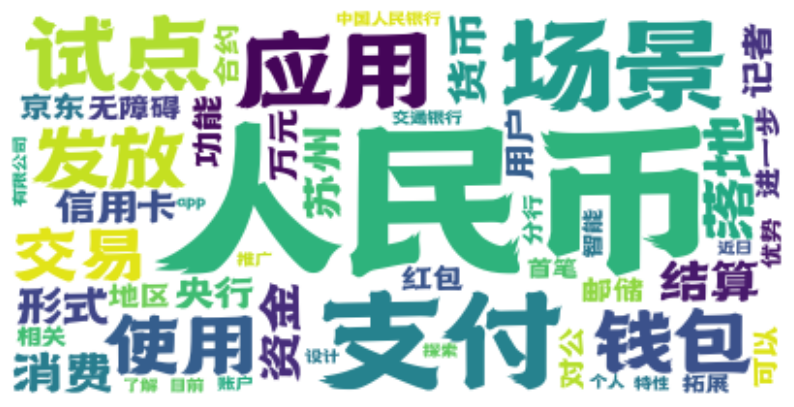

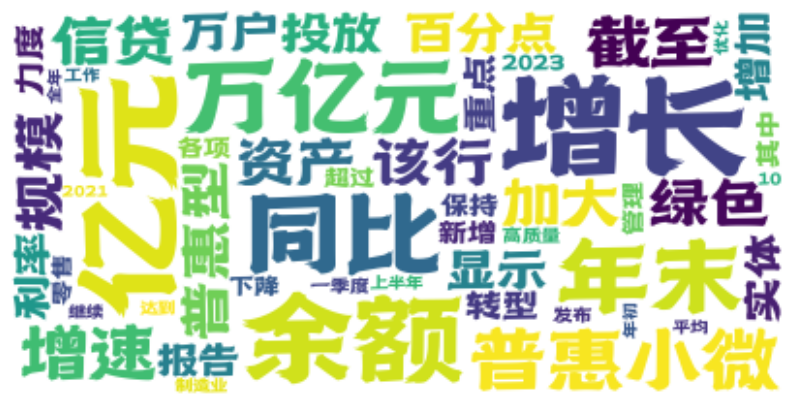

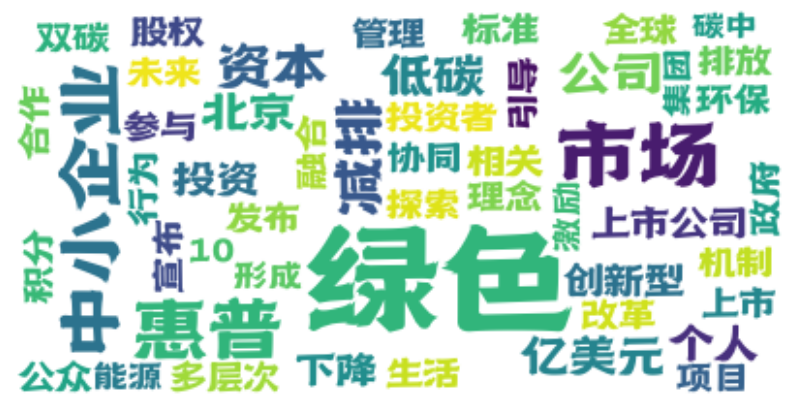

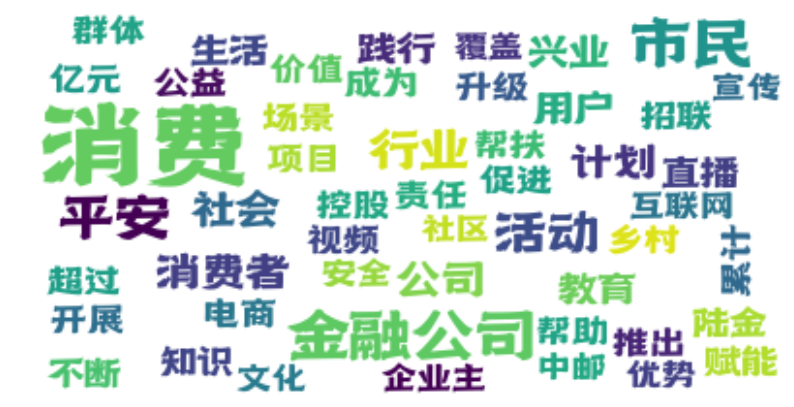

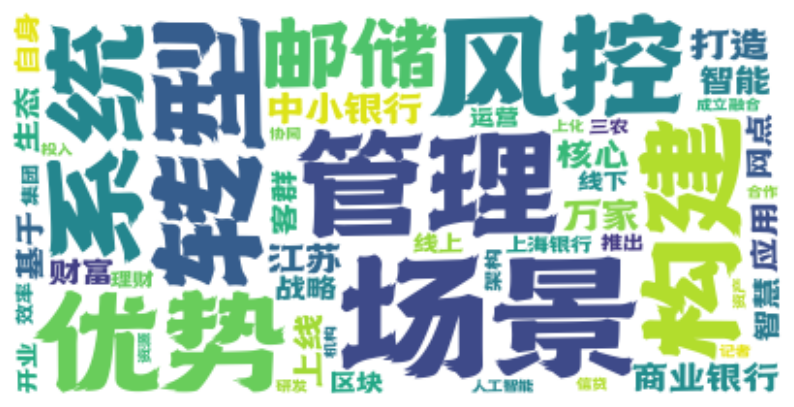

In [152]:
for  n_topics  in range(3,15):
    topic_path = os.path.join(path_result,str(n_topics))
    if not os.path.exists(topic_path):
            os.makedirs(topic_path)
    lda = LatentDirichletAllocation(n_components=n_topics, max_iter=50,
                                    learning_method='batch',
                                    learning_offset=50,
    #                                 doc_topic_prior=0.1,
    #                                 topic_word_prior=0.01,
                                random_state=0)
    lda.fit(tf)
    vec_lda = lda.transform(tf)

    n_top_words = 25
    tf_feature_names = tf_vectorizer.get_feature_names_out()
    topic_word = print_top_words(lda, tf_feature_names, n_top_words)
    topic_text_path = os.path.join(topic_path,'topic.txt')
    write_list_to_txt(topic_word,topic_text_path)

    topics=lda.transform(tf)
    topic = []
    for t in topics:
        topic.append("Topic #"+str(list(t).index(np.max(t))))

    data_frame['概率最大的主题序号']=topic
    data_frame['每个主题对应概率']=list(topics)
    excel_path = os.path.join(topic_path,'data_topic.xlsx')
    data_frame.to_excel(excel_path,index=False)

    for topic_idx, topic in enumerate(lda.components_):
        
        generate_wordcloud(list(tf_feature_names),list(topic),path=topic_path,topic_number=topic_idx)
    

In [124]:
topic_word

['人民币 场景 支付 消费 租赁 应用 试点 使用 钱包 发放 交易 生活 宁波 活动 政务 资金 落地 记者 结算 民生 功能 用户 app 信用卡 体验',
 '乡村 农村 振兴 转型 产业 农业 信息 融合 市场 地区 改革 完善 监管 加快 我国 信用 促进 基础 中小 加强 机制 工作 政策 应用 合作',
 '消费 增长 亿元 余额 普惠小微 万亿元 同比 增速 疫情 加大 信贷 政策 利率 金融公司 力度 百分点 显示 增加 规模 进一步 影响 截至 普惠型 投放 2021',
 '分行 亿元 乡村 振兴 担保 推出 线上 市民 该行 万元 农村 累计 信贷 资金 邮储 有限公司 截至 工作 授信 公司 打造 农商 积极 特色 单位',
 '上海 深圳 实体 微众 高质量 产业 打造 顾问 金融业 万家 深圳市 中小 重点 战略 合作 重要 优势 转型 上海市 管理 全球 国家 成立 大众 制度',
 '健康 消费者 公司 风险 保护 行业 报告 保险 案例 机构 担保 社会 财务 协会 关注 高质量 群体 我国 家庭 权益 研究 未来 问题 政策 教育',
 '绿色 亿元 转型 增长 北京 年末 该行 资产 管理 惠普 打造 截至 兴业银行 实体 战略 同比 减排 赋能 个人 财富 公司 零售 esg 建行 国际',
 '问题 风险 可以 信息 需要 成本 风控 解决 我们 用户 场景 进行 传统 应用 成为 一个 信用 保险 如何 目前 精准 记者 保障 系统 商业银行']

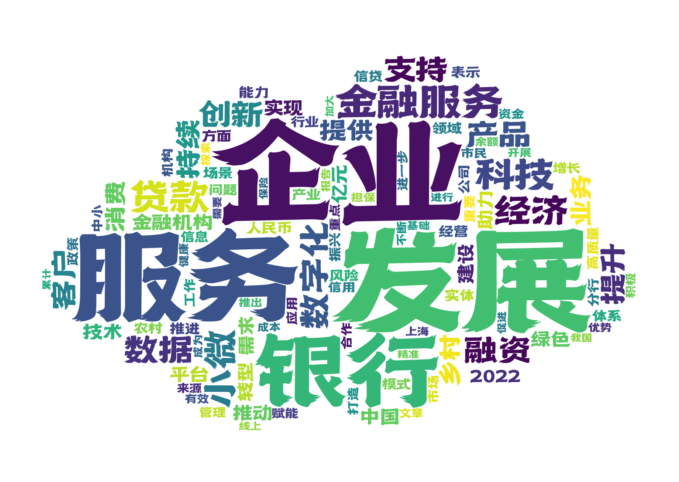

In [113]:
# 全部词云生成
total_word_list = []
for index,row in data_frame.iterrows():
    seg_list = jieba.lcut(row['total_content'])
    for seg_word in seg_list:
        if (seg_word not in stop_list) and len(seg_word)>1 :
            total_word_list.append(seg_word)
generate_wordcloud_gernel(total_word_list)

In [71]:
lda.components_.shape

(8, 3335)

In [49]:
plexs = []
scores = []
n_max_topics = 16
for i in range(1,n_max_topics):
    print(i)
    lda = LatentDirichletAllocation(n_components=i, max_iter=50,
                                    learning_method='batch',
                                    learning_offset=50,random_state=0)
    lda.fit(tf)
    plexs.append(lda.perplexity(tf))
    scores.append(lda.score(tf))

1
2
3
4
5
6
7
8
9
10
11
12
13
14
15


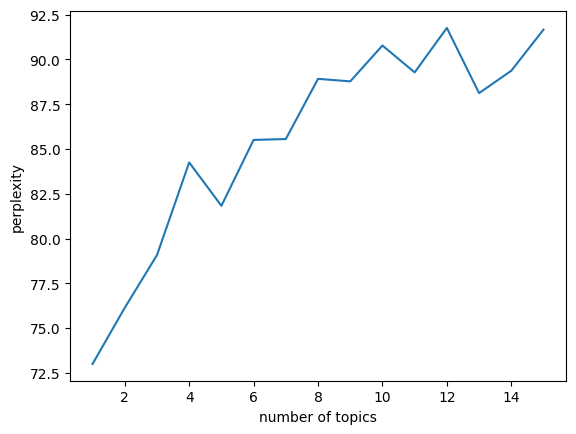

In [50]:
n_t=15#区间最右侧的值。注意：不能大于n_max_topics
x=list(range(1,n_t+1))
plt.plot(x,plexs[0:n_t])
plt.xlabel("number of topics")
plt.ylabel("perplexity")
plt.show()

In [55]:
topics=lda.transform(tf)
topic = []
for t in topics:
    topic.append("Topic #"+str(list(t).index(np.max(t))))
data_frame['概率最大的主题序号']=topic
data_frame['每个主题对应概率']=list(topics)
data_frame.to_excel("data_topic.xlsx",index=False)

In [ ]:
from collections import Counter
def plot_proj(embedding, lbs):
    """
    Plot UMAP embeddings
    :param embedding: UMAP (or other) embeddings
    :param lbs: labels
    """
    n = len(embedding)
    counter = Counter(lbs)
    for i in range(len(np.unique(lbs))):
        plt.plot(embedding[:, 0][lbs == i], embedding[:, 1][lbs == i], '.', alpha=0.5,
                 label='cluster {}: {:.2f}%'.format(i, counter[i] / n * 100))
    plt.legend()

def visualize(final_vec,culster_model):
    """
    Visualize the result for the topic model by 2D embedding (UMAP)
    :param model: Topic_Model object
    """

    reducer = umap.UMAP()
    print('Calculating UMAP projection ...')
    vec_umap = reducer.fit_transform(final_vec)
    # vec_umap = pca_2d(final_vec)
    # print('Calculating UMAP projection. Done!')
    plot_proj(vec_umap,culster_model.labels_)
    # dr = '/contextual_topic_identification/docs/images/{}/{}'.format(model.method, model.id)
    # if not os.path.exists(dr):
    #     os.makedirs(dr)
    # plt.savefig(dr + '/2D_vis')

In [ ]:
def plot_proj(embedding, lbs):
    """
    Plot UMAP embeddings
    :param embedding: UMAP (or other) embeddings
    :param lbs: labels
    """
    n = len(embedding)
    counter = Counter(lbs)
    for i in range(len(np.unique(lbs))):
        plt.plot(embedding[:, 0][lbs == i], embedding[:, 1][lbs == i], '.', alpha=0.5,
                 label='cluster {}: {:.2f}%'.format(i, counter[i] / n * 100))
    plt.legend()

def visualize(final_vec,bert_name,cluster_method,gamma):
    """
    Visualize the result for the topic model by 2D embedding (UMAP)
    :param model: Topic_Model object
    """

    reducer = umap.UMAP()
    print('Calculating UMAP projection ...')
    vec_umap = reducer.fit_transform(final_vec)
    for num_group in range(3,10):
    # for num_group in[5]:    
        clu_model = AE2cluster(final_vec,num_group=num_group,method=cluster_method)   
        plot_proj(vec_umap,clu_model.labels_)
        dr = os.path.join(culster_result_path,bert_name[4:],cluster_method.__name__)
        if not os.path.exists(dr):
            os.makedirs(dr)
        plt.savefig(os.path.join(dr,f'{gamma}_{num_group}.png'))
        plt.savefig(os.path.join(dr,f'bert.png'))
        plt.close()